In [25]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix ,classification_report,accuracy_score,recall_score,precision_score,f1_score
import math
from sklearn.model_selection import cross_val_score,learning_curve,train_test_split
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation
import keras
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from keras.models import Sequential
import itertools
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
np.random.seed(1337) # for reproducibility
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from sklearn.neural_network import MLPClassifier
from keras.models import Sequential
from keras.layers import Dense
from sklearn.model_selection import StratifiedKFold
from sklearn.neighbors import KNeighborsClassifier
from sklearn.datasets.samples_generator import make_blobs
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture as GMM
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO  
from IPython.display import Image  
import pydotplus
from sklearn.decomposition import PCA
from sklearn.decomposition import FastICA
import itertools
from sklearn.metrics import silhouette_score

In [4]:
#Read Data
datadf=pd.read_csv("credit_train.csv")


### Dropping Features

In [5]:
datadf = datadf.drop(columns=['Customer ID','Loan ID'])

#### Correlation Check

In [6]:
# Function of Correlation
def correlation(data, threshold=0.60):
    col_corr = set()  # Set of all the names of deleted columns
    corr_matrix = data.corr()
    print('Correlation with more than',threshold)
    print('Corr Value',"\t""\t", 'Fearture1', "\t", 'Feature 2')
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if (corr_matrix.iloc[i, j] >= threshold) and (corr_matrix.columns[j] not in col_corr):
                print(corr_matrix.iloc[i, j], "\t", corr_matrix.columns[i], "\t" "\t", corr_matrix.columns[j])

In [7]:
correlation(datadf)

Correlation with more than 0.6
Corr Value 		 Fearture1 	 Feature 2
0.752941940519514 	 Bankruptcies 		 Number of Credit Problems


In [8]:
datadf.drop(columns=['Number of Credit Problems'])

,Loan Status,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Months since last delinquent,Number of Open Accounts,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
0,Fully Paid,445412.0,Short Term,709.0,1167493.0,8 years,Home Mortgage,Home Improvements,5214.74,17.2,NaN,6.0,228190.0,416746.0,1.0,0.0
1,Fully Paid,262328.0,Short Term,NaN,NaN,10+ years,Home Mortgage,Debt Consolidation,33295.98,21.1,8.0,35.0,229976.0,850784.0,0.0,0.0
2,Fully Paid,99999999.0,Short Term,741.0,2231892.0,8 years,Own Home,Debt Consolidation,29200.53,14.9,29.0,18.0,297996.0,750090.0,0.0,0.0
3,Fully Paid,347666.0,Long Term,721.0,806949.0,3 years,Own Home,Debt Consolidation,8741.90,12.0,NaN,9.0,256329.0,386958.0,0.0,0.0
4,Fully Paid,176220.0,Short Term,NaN,NaN,5 years,Rent,Debt Consolidation,20639.70,6.1,NaN,15.0,253460.0,427174.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100509,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
100510,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
100511,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
100512,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Dropping Not Available records

In [9]:
datadf_con = datadf.dropna()

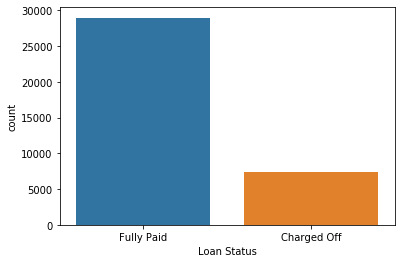

In [10]:
sns.countplot(x='Loan Status',data =datadf_con)

#### Categorical Variables Transformation

In [11]:
datadf_con['Loan Status'] = [0 if x == 'Fully Paid' else 1 for x in datadf_con['Loan Status']]


C:\Users\saipr\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [12]:
datadf_con['Term'] = [0 if x == 'Short Term' else 1 for x in datadf_con['Term']]

C:\Users\saipr\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [13]:
datadf_con['Years in current job']=datadf_con['Years in current job'].str.extract(r"(\d+)")
datadf_con['Years in current job'] = datadf_con['Years in current job'].astype(float)

C:\Users\saipr\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
C:\Users\saipr\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [14]:
datadf_con['Purpose'].replace('other','Other',inplace = True)

C:\Users\saipr\Anaconda3\lib\site-packages\pandas\core\generic.py:6786: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._update_inplace(new_data)


In [15]:
datadf_con_copy = datadf_con.copy()
datadf_con = datadf_con.drop(['Purpose','Home Ownership','Term'],axis=1)


In [16]:
datadf_f = pd.get_dummies(datadf_con)
datadf_f.columns

Index(['Loan Status', 'Current Loan Amount', 'Credit Score', 'Annual Income',
       'Years in current job', 'Monthly Debt', 'Years of Credit History',
       'Months since last delinquent', 'Number of Open Accounts',
       'Number of Credit Problems', 'Current Credit Balance',
       'Maximum Open Credit', 'Bankruptcies', 'Tax Liens'],
      dtype='object')

### X and Y datasets

In [17]:
datadf_f_x = datadf_f.drop(columns=['Loan Status'])

In [18]:
scaler = StandardScaler()
datadf_sc = scaler.fit_transform(datadf_f)
datadf_sc = pd.DataFrame(datadf_sc, columns=datadf_f.columns)
datadf_sc = datadf_sc.drop(columns=['Loan Status'])

In [19]:
y = datadf_f['Loan Status']
x = datadf_sc

In [20]:
y = pd.DataFrame(y)
y = y.reset_index(drop =True) 

In [21]:
x_ft = x.copy()
y_ft = y.copy()

In [22]:
# Simple K Means

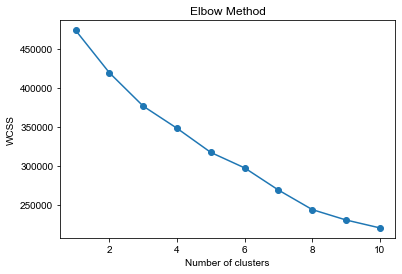

In [23]:
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(x)
    wcss.append(kmeans.inertia_)
plt.plot(range(1, 11), wcss,marker ='o')
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
sns.set_style("whitegrid")
plt.ylabel('WCSS')
plt.show()

In [26]:
sil_score = []
for k in range(2,10):
    kmeans = KMeans( n_clusters=k,n_init=100 ).fit(x)
    pred_y = kmeans.fit_predict(x)
    sil_score.append(silhouette_score( x,pred_y ))

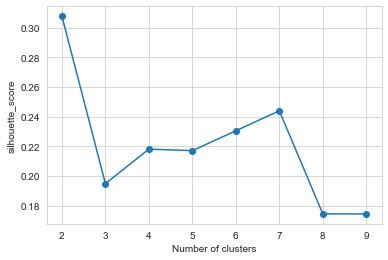

In [27]:
plt.plot(range(2, 10), sil_score,marker ='o')
# plt.title('Elbow Method')
plt.xlabel('Number of clusters')
sns.set_style("whitegrid")
plt.ylabel('silhouette_score')
plt.show()

In [269]:
kmeans = KMeans(n_clusters=2, init='k-means++', max_iter=300, n_init=10, random_state=0)
pred_y = kmeans.fit_predict(x)
pred_y=pred_y+1
pred_y =pd.DataFrame(pred_y,columns=['Cluster'])
km_df = pd.concat([x,y,pred_y],axis=1)


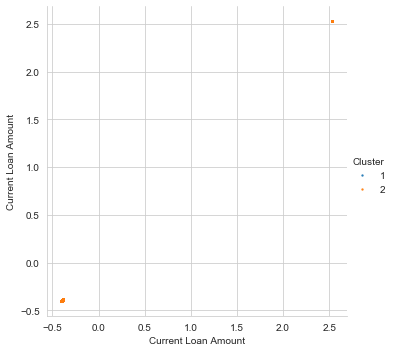

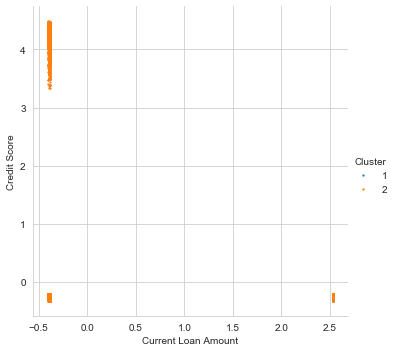

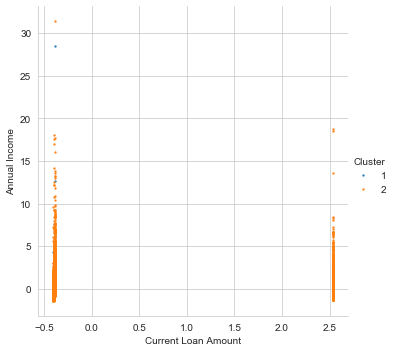

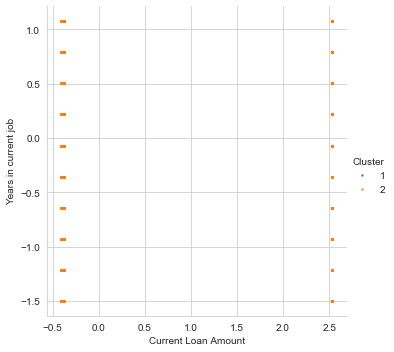

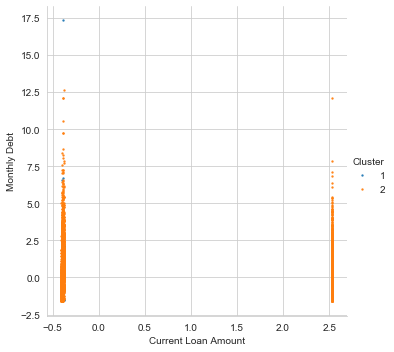

...

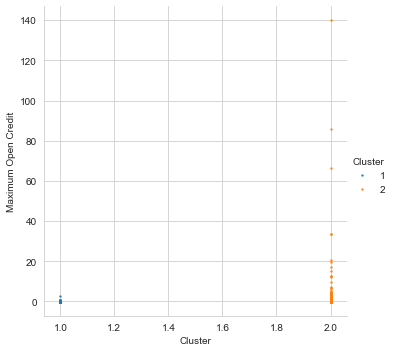

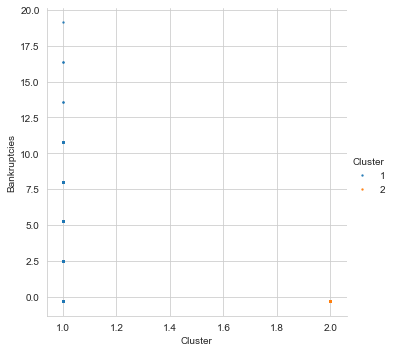

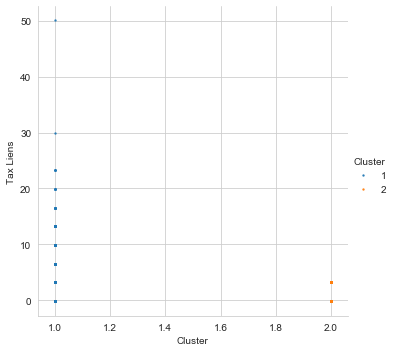

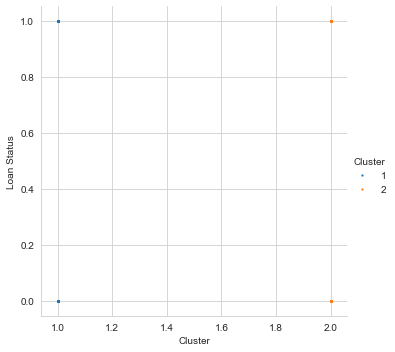

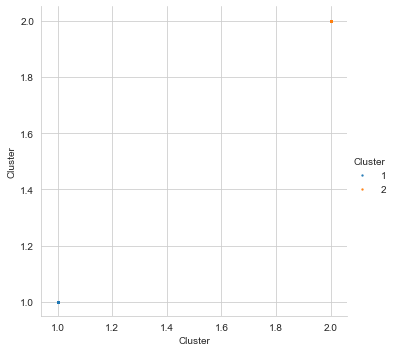

In [275]:
for i in km_df.columns:
    for j in km_df.columns:
        sns.lmplot(data=km_df, x=i, y=j,hue='Cluster',fit_reg=False, legend=True, scatter_kws={"s": 2},legend_out=True)
        plt.show()

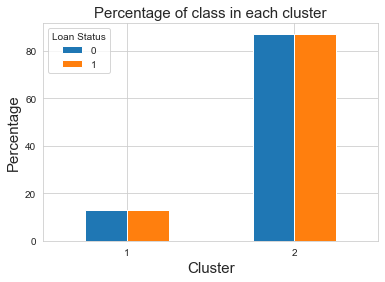

In [273]:
temp1 = pd.DataFrame(km_df.groupby(['Cluster','Loan Status']).size(),columns=['Cluster_class_count']).reset_index()
temp2 = pd.DataFrame(km_df['Loan Status'].value_counts())
temp2.columns = ['Total_Class_count']
temp_final = pd.concat([temp2,temp2],axis=0).reset_index(drop=True)
df_obs = pd.concat([temp1,temp_final],axis=1)
df_obs['Percent_class'] = df_obs['Cluster_class_count']/df_obs['Total_Class_count']*100
df_obs.pivot("Cluster", "Loan Status", "Percent_class").plot(kind='bar')
plt.xlabel("Cluster",fontsize=15)
plt.ylabel("Percentage",fontsize=15)
plt.xticks(rotation = 0)
plt.title("Percentage of class in each cluster",fontsize=15)
plt.show()

In [ ]:
#Simple EX MAX

In [30]:
em_sil_score = []
for k in range(2,10):
    gmm = GMM(n_components=k).fit(x)
    gmm_pred_y = gmm.predict(x)
    em_sil_score.append(silhouette_score( x,gmm_pred_y ))

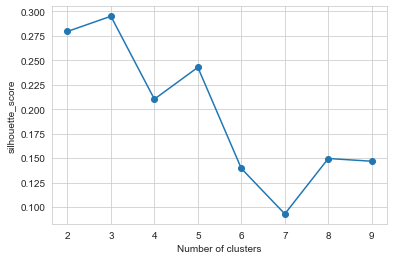

In [31]:
plt.plot(range(2, 10), em_sil_score,marker ='o')
# plt.title('Elbow Method')
plt.xlabel('Number of clusters')
sns.set_style("whitegrid")
plt.ylabel('silhouette_score')
plt.show()

In [35]:
gmm = GMM(n_components=3).fit(x)
gmm_pred_y = gmm.predict(x)
gmm_pred_y=gmm_pred_y+1
gmm_pred_y =pd.DataFrame(gmm_pred_y,columns=['Cluster'])
gmm_df = pd.concat([x,y,gmm_pred_y],axis=1)

In [261]:
gmm_df['Loan Status'].value_counts()

0    28972
1     7451
Name: Loan Status, dtype: int64

In [267]:
gmm_gb

,0
Loan Status,
0,3
1,2


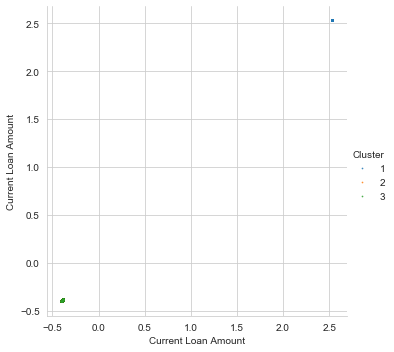

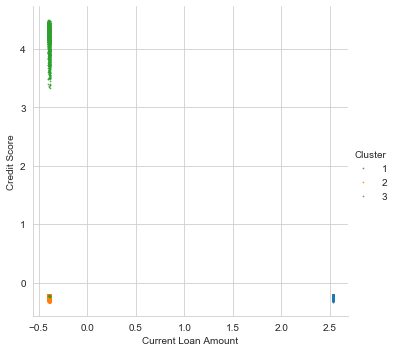

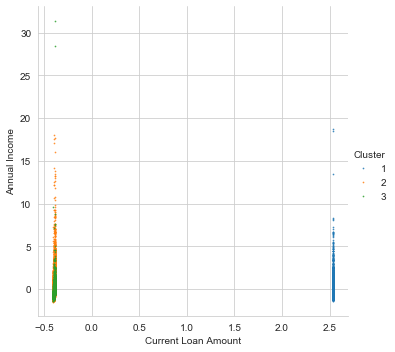

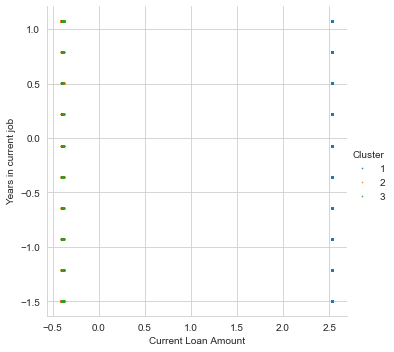

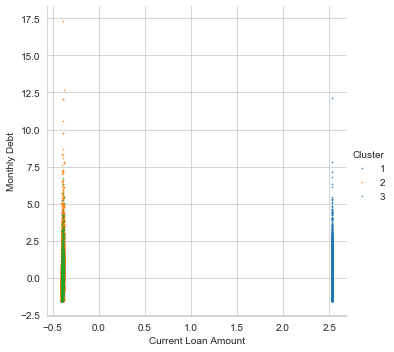

...

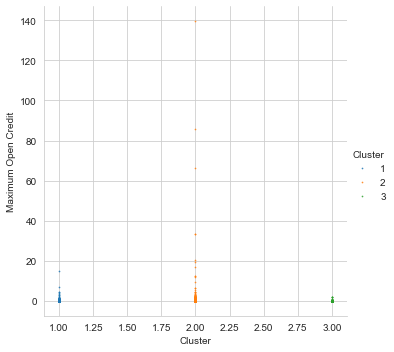

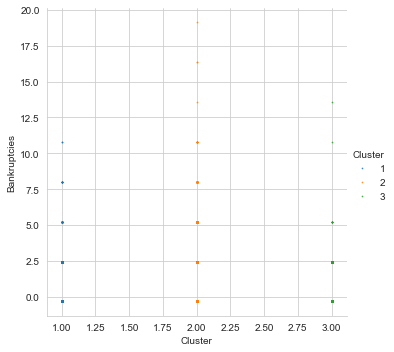

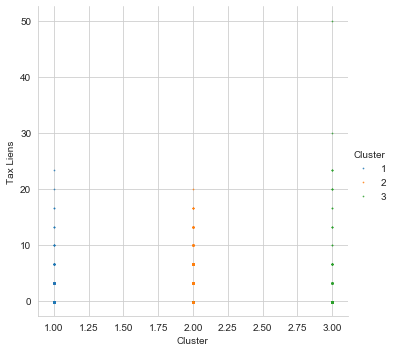

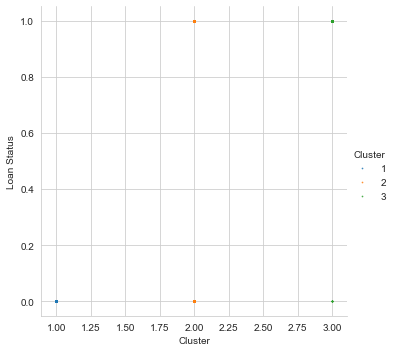

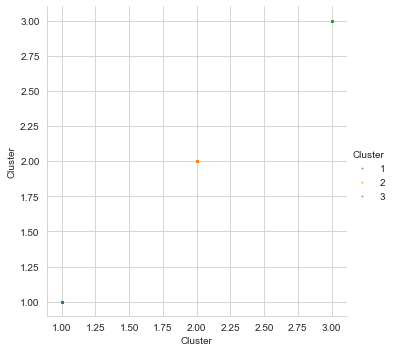

In [36]:
for i in gmm_df.columns:
    for j in gmm_df.columns:
        sns.lmplot(data=gmm_df, x=i, y=j,hue='Cluster',fit_reg=False, legend=True, scatter_kws={"s": 0.5},legend_out=True)
        plt.show()

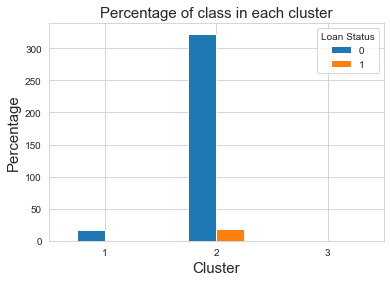

In [274]:
temp1 = pd.DataFrame(gmm_df.groupby(['Cluster','Loan Status']).size(),columns=['Cluster_class_count']).reset_index()
temp2 = pd.DataFrame(gmm_df['Loan Status'].value_counts())
temp2.columns = ['Total_Class_count']
temp_final = pd.concat([temp2,temp2],axis=0).reset_index(drop=True)
df_obs = pd.concat([temp1,temp_final],axis=1)
df_obs['Percent_class'] = df_obs['Cluster_class_count']/df_obs['Total_Class_count']*100
df_obs.pivot("Cluster", "Loan Status", "Percent_class").plot(kind='bar')
plt.xlabel("Cluster",fontsize=15)
plt.ylabel("Percentage",fontsize=15)
plt.xticks(rotation = 0)
plt.title("Percentage of class in each cluster",fontsize=15)
plt.show()

In [284]:
df_obs

,Cluster,Loan Status,Cluster_class_count,Total_Class_count,Percent_class
0,1,0,4918,28972.0,16.975010
1,2,0,24045,7451.0,322.708361
2,2,1,5494,28972.0,18.963137
3,3,0,9,7451.0,0.120789
4,3,1,1957,NaN,NaN


In [ ]:
#Feature Selection

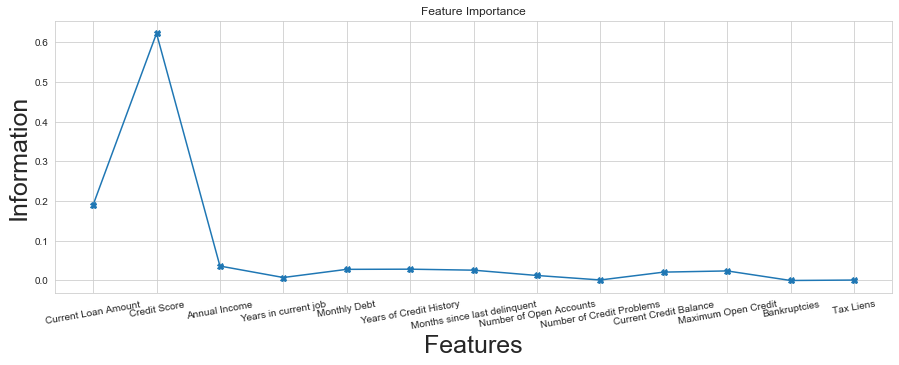

In [280]:
d_clf = DecisionTreeClassifier(criterion="entropy", max_depth= 15, max_features = 0.6,max_leaf_nodes =275)
d_clf = d_clf.fit(x,y)
best_features=dict(zip(x.columns, d_clf.feature_importances_.round(4)))
best_features=pd.DataFrame(best_features,index=['Importance']).T
plt.figure(figsize=(15,5))
plt.plot(best_features,marker='X')
plt.xticks(rotation=10)
plt.title('Feature Importance')
plt.xlabel('Features',fontsize=25)
plt.ylabel('Information',fontsize=25)
sns.set_style("whitegrid")
plt.show()

In [277]:
best_features.sort_values(by='Importance', ascending = False).T


,Credit Score,Current Loan Amount,Annual Income,Monthly Debt,Years of Credit History,Number of Open Accounts,Maximum Open Credit,Current Credit Balance,Months since last delinquent,Years in current job,Tax Liens,Bankruptcies,Number of Credit Problems
Importance,0.573,0.2465,0.0451,0.0403,0.0221,0.0171,0.0152,0.0145,0.0134,0.0076,0.0022,0.0017,0.0011


In [43]:
dt_df = pd.DataFrame()
dt_df [['Credit Score','Current Loan Amount','Annual Income','Maximum Open Credit','Current Credit Balance','Monthly Debt']] =x[['Credit Score','Current Loan Amount','Annual Income','Maximum Open Credit','Current Credit Balance','Monthly Debt']]

In [ ]:
#PCA

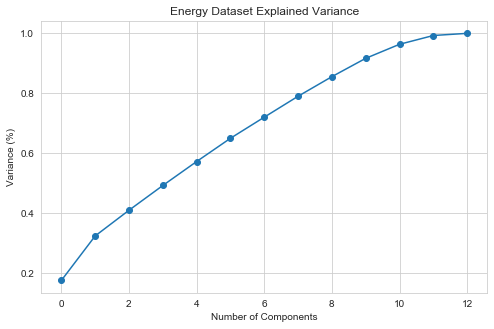

In [44]:
#Fitting the PCA algorithm with our Data
pca = PCA().fit(x)
#Plotting the Cumulative Summation of the Explained Variance
plt.figure(figsize=(8,5))
plt.plot(np.cumsum(pca.explained_variance_ratio_),marker = 'o')
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)') #for each component
sns.set_style("whitegrid")
plt.title('Energy Dataset Explained Variance')
plt.show()

In [45]:
pca = PCA(n_components=10)
Principal_Components = pca.fit_transform(x)
pca_df = pd.DataFrame(data = Principal_Components
             , columns = ['Principal_Component_1', 'Principal_Component_2','Principal_Component_3','Principal_Component_4','Principal_Component_5','Principal_Component_6','Principal_Component_7','Principal_Component_8','Principal_Component_9','Principal_Component_10'])

In [61]:
# pca_df_xy = pd.concat([pca_df,y],axis=1)
# for i in pca_df_xy.columns:
#     for j in pca_df_xy.columns:
#         sns.lmplot(data=pca_df_xy, x=i, y=j,hue='Loan Status',fit_reg=False, legend=True, scatter_kws={"s": 2},legend_out=True)
#         plt.show()

In [ ]:
#ICA

In [58]:
ica = FastICA(random_state=99)
x_ica = ica.fit_transform(x)
ica_df = pd.DataFrame(data = x_ica
             , columns = x.columns)

In [189]:
import scipy
kt_ica = scipy.stats.kurtosis(ica_df)
kt_ica_df = pd.DataFrame(kt_ica)
kt_ica_df = kt_ica_df.T
kt_ica_df.columns = x.columns
kt_ica_df = kt_ica_df.T

In [190]:
#RUN only once after you remove comments
kt_ica_df.reset_index(inplace = True,drop=False)

In [191]:
kt_ica_df.columns=['Features','Kurtosis_Values']

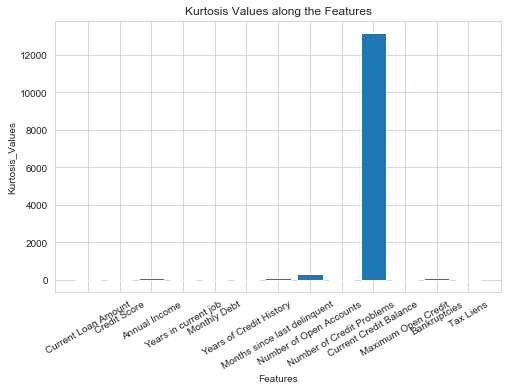

In [283]:
#Kurtosis Values along the Features
plt.figure(figsize=(8,5))
plt.bar(kt_ica_df['Features'],kt_ica_df['Kurtosis_Values'])
plt.xlabel('Features')
plt.ylabel('Kurtosis_Values') #for each component
plt.xticks(rotation=30)
sns.set_style("whitegrid")
plt.title('Kurtosis Values along the Features')
plt.show()

In [ ]:
#imp features are 'Annual Income','Months since last delinquent','Number of Open Accounts','Current Credit Balance','Bankruptcies'

In [69]:
ica_df_final = pd.DataFrame()
ica_df_final[['Annual Income','Months since last delinquent','Number of Open Accounts','Current Credit Balance','Bankruptcies']] = ica_df[['Annual Income','Months since last delinquent','Number of Open Accounts','Current Credit Balance','Bankruptcies']]

In [71]:
# ica_df_xy = pd.concat([ica_df_final,y],axis=1)
# for i in ica_df_xy.columns:
#     for j in ica_df_xy.columns:
#         sns.lmplot(data=ica_df_xy, x=i, y=j,hue='Loan Status',fit_reg=False, legend=True, scatter_kws={"s": 2},legend_out=True)
#         plt.show()

In [ ]:
#Randomized Optimization

In [72]:
from sklearn import random_projection
ro_df = random_projection.GaussianRandomProjection(n_components=4)
ro_df = pd.DataFrame(ro_df.fit_transform(x))

In [73]:
ro_df.columns=['Random_Component_1','Random_Component_2','Random_Component_3','Random_Component_4']

In [ ]:
#Clustering after Dimension Reduction

In [ ]:
#DT

In [ ]:
#K means DT

In [77]:
dt_km_sil_score = []
for k in range(2,10):
    kmeans = KMeans( n_clusters=k,n_init=100 ).fit(dt_df)
    pred_y = kmeans.fit_predict(dt_df)
    dt_km_sil_score.append(silhouette_score( dt_df,pred_y ))

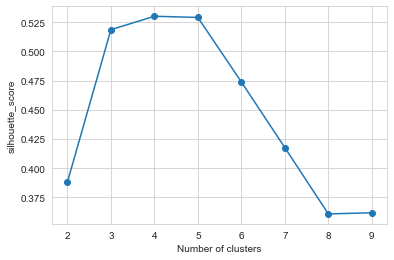

In [78]:
plt.plot(range(2,10), dt_km_sil_score,marker ='o')
# plt.title('Elbow Method')
plt.xlabel('Number of clusters')
sns.set_style("whitegrid")
plt.ylabel('silhouette_score')
plt.show()

In [79]:
dt_kmeans = KMeans(n_clusters=4, init='k-means++', max_iter=300, n_init=10, random_state=0)
dt_pred_y = dt_kmeans.fit_predict(dt_df)
dt_pred_y = dt_pred_y+1
dt_pred_y =pd.DataFrame(dt_pred_y,columns=['Cluster'])
dt_km_df = pd.concat([dt_df,y,dt_pred_y],axis=1)

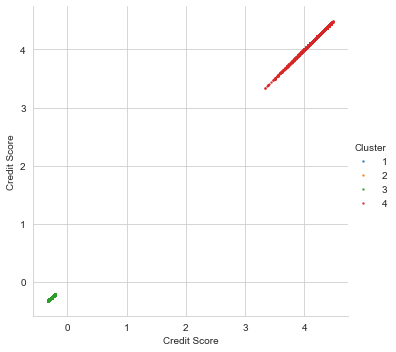

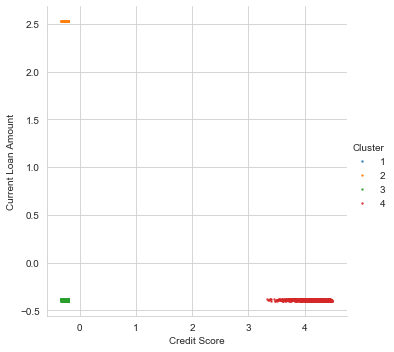

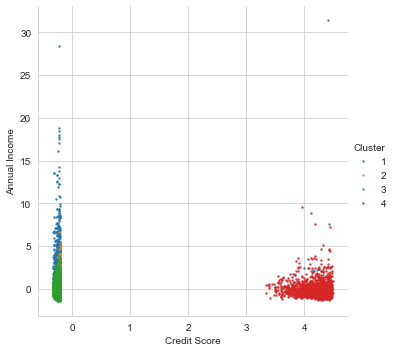

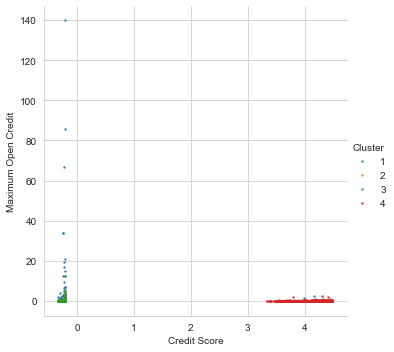

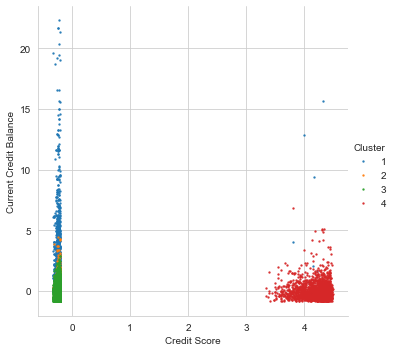

...

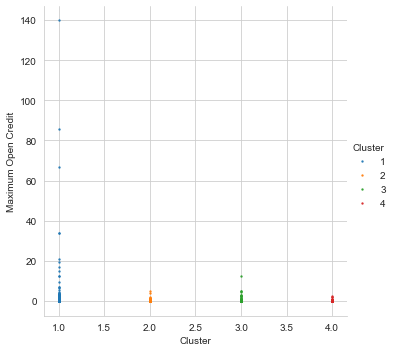

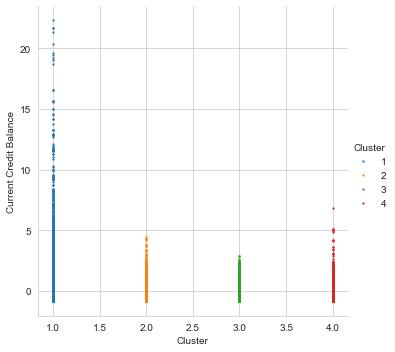

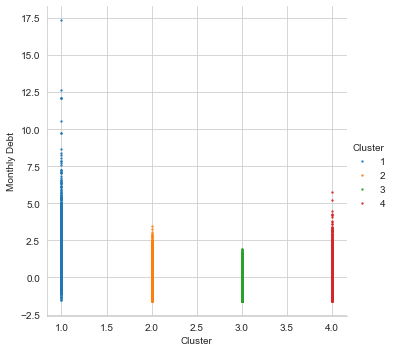

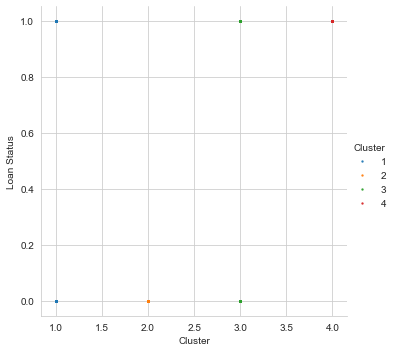

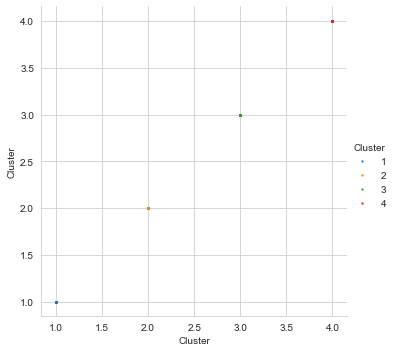

In [80]:
for i in dt_km_df.columns:
    for j in dt_km_df.columns:
        sns.lmplot(data=dt_km_df, x=i, y=j,hue='Cluster',fit_reg=False, legend=True, scatter_kws={"s": 2},legend_out=True)
        plt.show()

In [ ]:
#EX MAX DT

In [81]:
dt_em_sil_score = []
for k in range(2,10):
    gmm = GMM(n_components=k).fit(dt_df)
    dt_gmm_pred_y = gmm.predict(dt_df)
    dt_em_sil_score.append(silhouette_score( dt_df,dt_gmm_pred_y ))

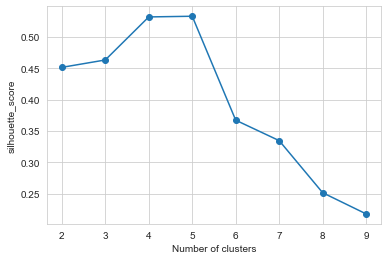

In [82]:
plt.plot(range(2, 10), dt_em_sil_score,marker ='o')
# plt.title('Elbow Method')
plt.xlabel('Number of clusters')
sns.set_style("whitegrid")
plt.ylabel('silhouette_score')
plt.show()

In [83]:
dt_gmm = GMM(n_components=5).fit(dt_df)
dt_em_pred_y = dt_gmm.predict(dt_df)
dt_em_pred_y = dt_em_pred_y+1
dt_em_pred_y =pd.DataFrame(dt_em_pred_y,columns=['Cluster'])
dt_em_df = pd.concat([dt_df,y,dt_em_pred_y],axis=1)

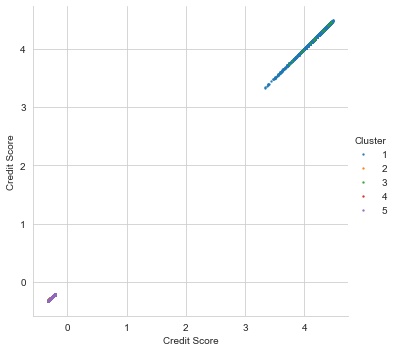

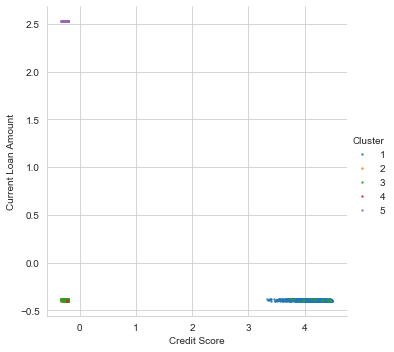

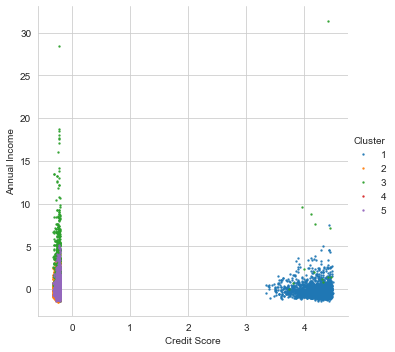

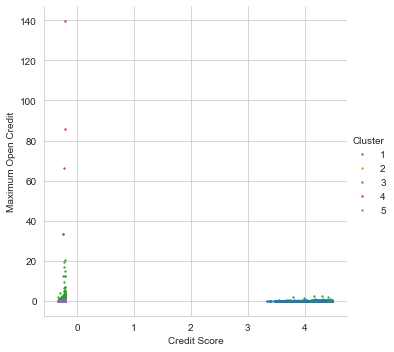

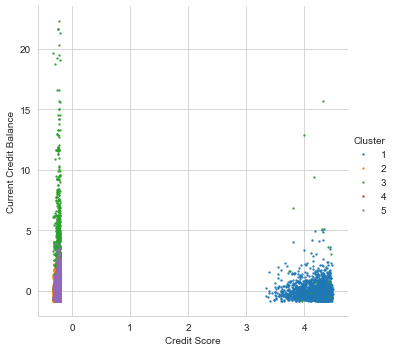

...

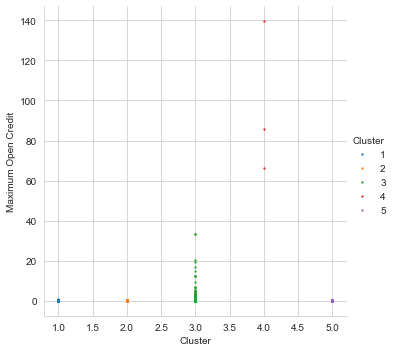

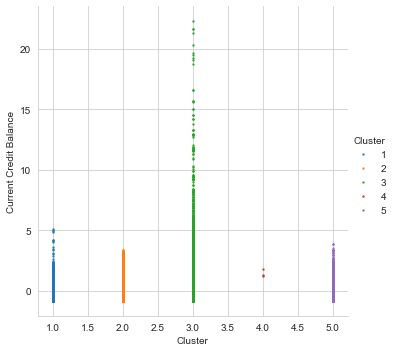

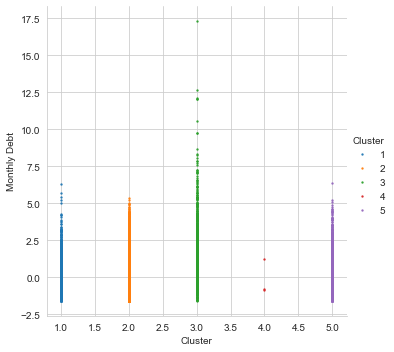

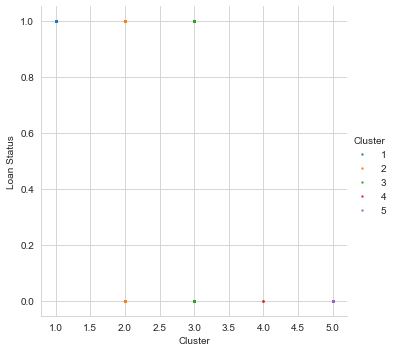

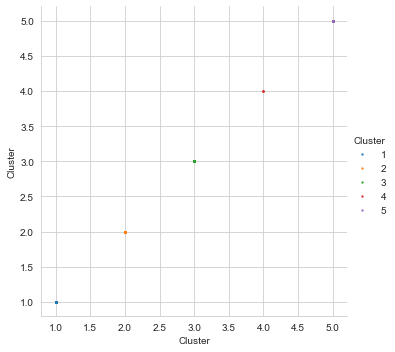

In [84]:
for i in dt_em_df.columns:
    for j in dt_em_df.columns:
        sns.lmplot(data=dt_em_df, x=i, y=j,hue='Cluster',fit_reg=False, legend=True, scatter_kws={"s": 2},legend_out=True)
        plt.show()

In [ ]:
#PCA KM

In [85]:
pca_km_sil_score = []
for k in range(2,10):
    kmeans = KMeans( n_clusters=k,n_init=100 ).fit(pca_df)
    pred_y = kmeans.fit_predict(pca_df)
    pca_km_sil_score.append(silhouette_score( pca_df,pred_y ))

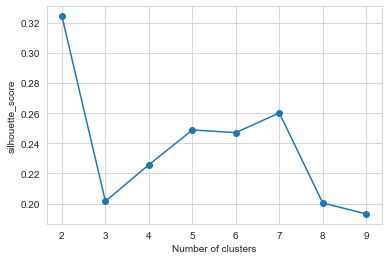

In [86]:
plt.plot(range(2, 10), pca_km_sil_score,marker ='o')
# plt.title('Elbow Method')
plt.xlabel('Number of clusters')
sns.set_style("whitegrid")
plt.ylabel('silhouette_score')
plt.show()

In [87]:
pca_kmeans = KMeans(n_clusters=2, init='k-means++', max_iter=300, n_init=10, random_state=0)
pca_pred_y = pca_kmeans.fit_predict(pca_df)
pca_pred_y = pca_pred_y+1
pca_pred_y =pd.DataFrame(pca_pred_y,columns=['Cluster'])
pca_km_df = pd.concat([pca_df,y,pca_pred_y],axis=1)

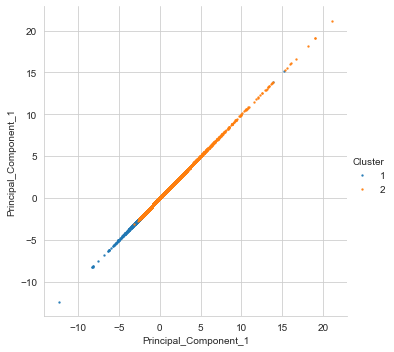

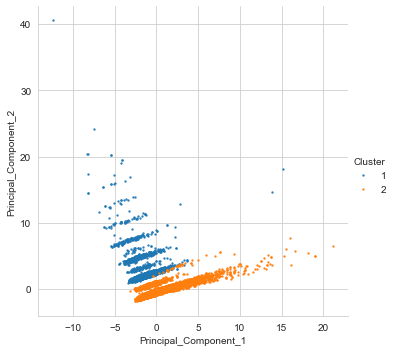

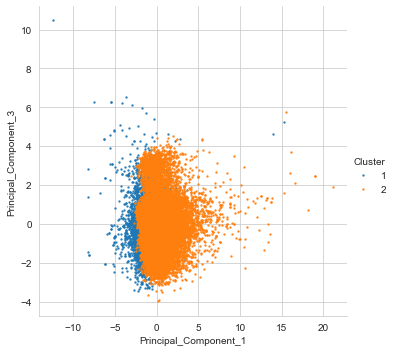

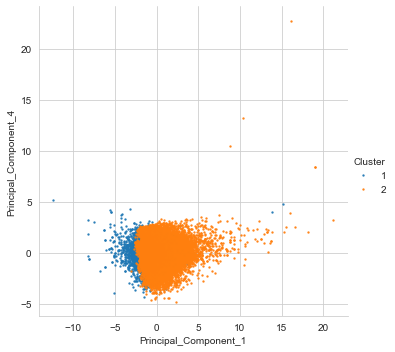

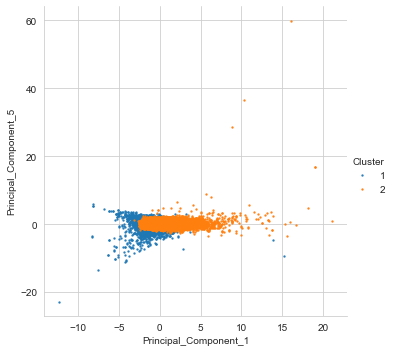

...

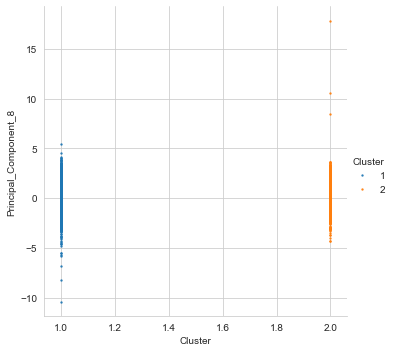

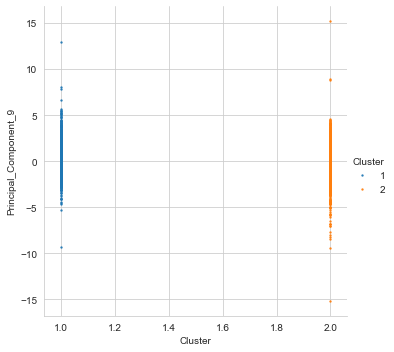

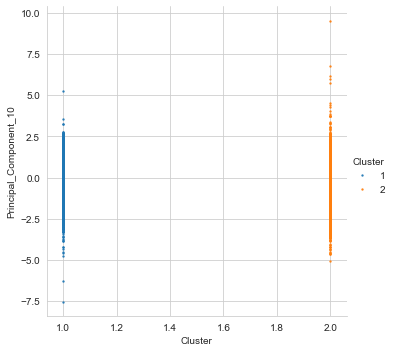

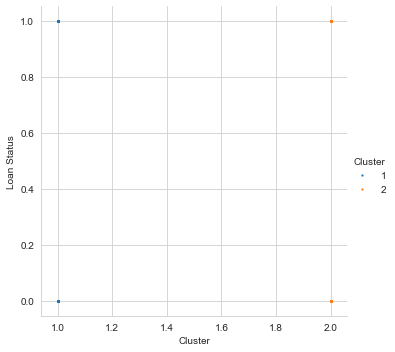

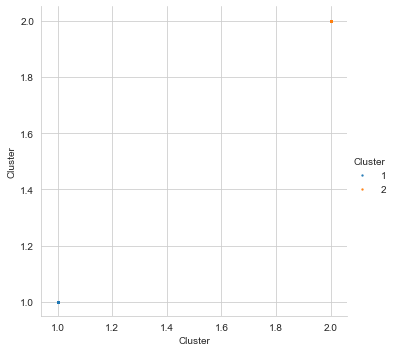

In [88]:
for i in pca_km_df.columns:
    for j in pca_km_df.columns:
        sns.lmplot(data=pca_km_df, x=i, y=j,hue='Cluster',fit_reg=False, legend=True, scatter_kws={"s": 2},legend_out=True)
        plt.show()

In [ ]:
#PCA EM

In [89]:
pca_em_sil_score = []
for k in range(2,10):
    gmm = GMM(n_components=k).fit(pca_df)
    pca_gmm_pred_y = gmm.predict(pca_df)
    pca_em_sil_score.append(silhouette_score( pca_df,pca_gmm_pred_y ))

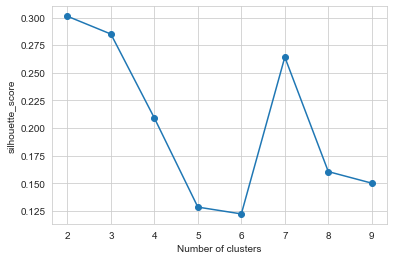

In [90]:
plt.plot(range(2, 10), pca_em_sil_score,marker ='o')
# plt.title('Elbow Method')
plt.xlabel('Number of clusters')
sns.set_style("whitegrid")
plt.ylabel('silhouette_score')
plt.show()

In [91]:
pca_gmm = GMM(n_components=2).fit(pca_df)
pca_em_pred_y = pca_gmm.predict(pca_df)
pca_em_pred_y = pca_em_pred_y+1
pca_em_pred_y =pd.DataFrame(pca_em_pred_y,columns=['Cluster'])
pca_em_df = pd.concat([pca_df,y,pca_em_pred_y],axis=1)

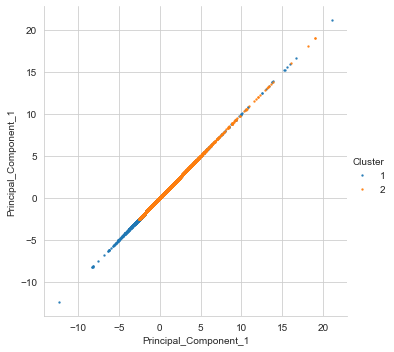

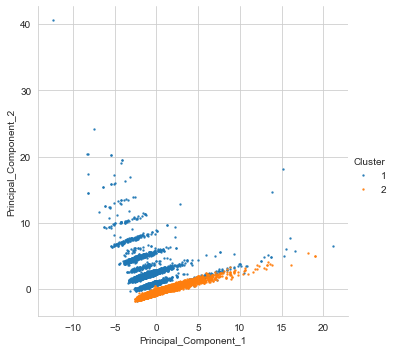

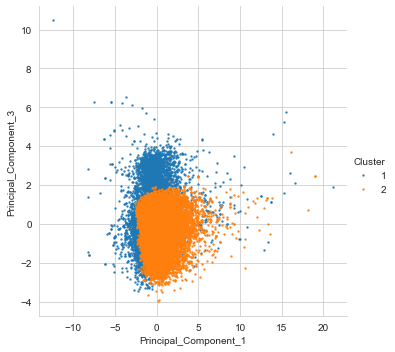

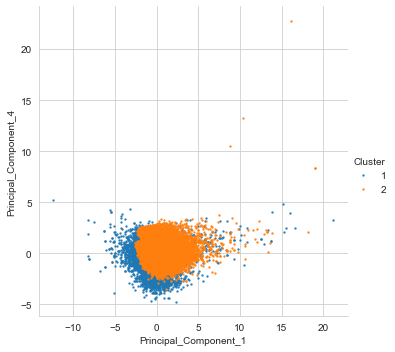

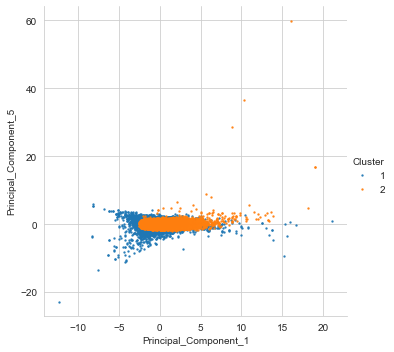

...

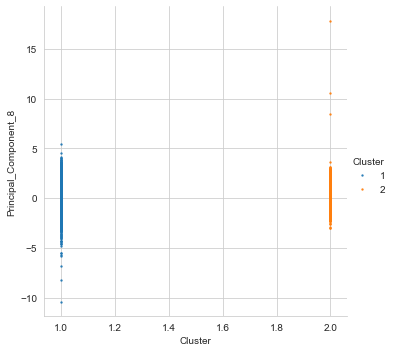

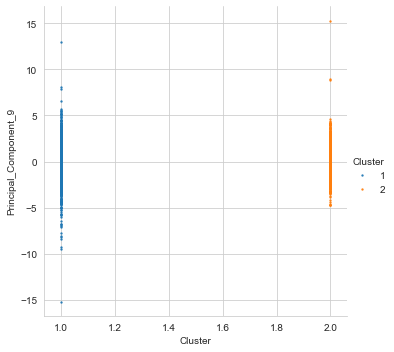

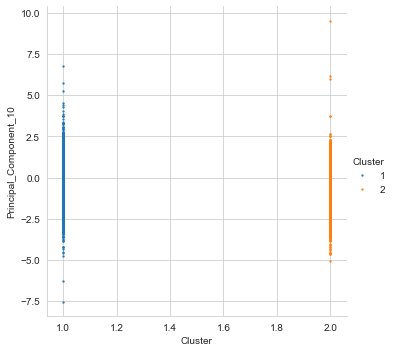

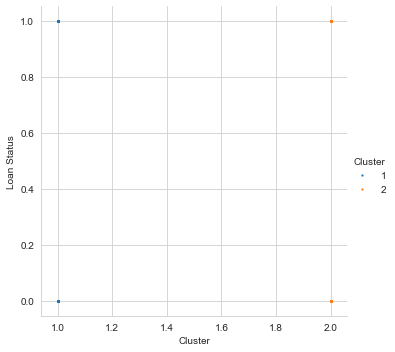

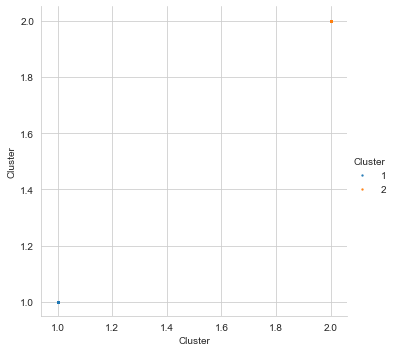

In [92]:
for i in pca_em_df.columns:
    for j in pca_em_df.columns:
        sns.lmplot(data=pca_em_df, x=i, y=j,hue='Cluster',fit_reg=False, legend=True, scatter_kws={"s": 2},legend_out=True)
        plt.show()

In [ ]:
#ICA KM

In [95]:
ica_km_sil_score = []
for k in range(2,10):
    kmeans = KMeans( n_clusters=k,n_init=100 ).fit(ica_df_final)
    pred_y = kmeans.fit_predict(ica_df_final)
    ica_km_sil_score.append(silhouette_score( ica_df_final,pred_y ))

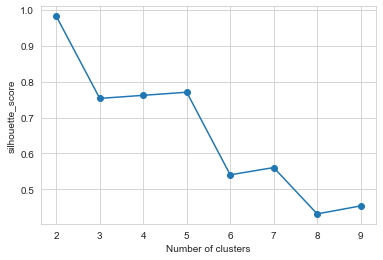

In [96]:
plt.plot(range(2, 10), ica_km_sil_score,marker ='o')
# plt.title('Elbow Method')
plt.xlabel('Number of clusters')
sns.set_style("whitegrid")
plt.ylabel('silhouette_score')
plt.show()

In [97]:
ica_kmeans = KMeans(n_clusters=2, init='k-means++', max_iter=300, n_init=10, random_state=5)
ica_pred_y = ica_kmeans.fit_predict(ica_df_final)
ica_pred_y = ica_pred_y+1
ica_pred_y =pd.DataFrame(ica_pred_y,columns=['Cluster'])
ica_km_df = pd.concat([ica_df_final,y,ica_pred_y],axis=1)

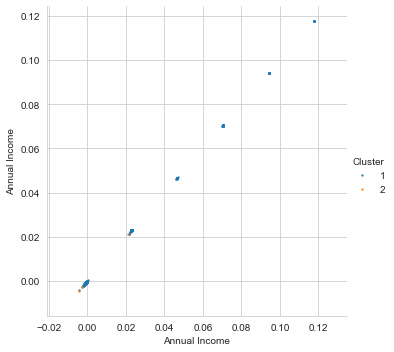

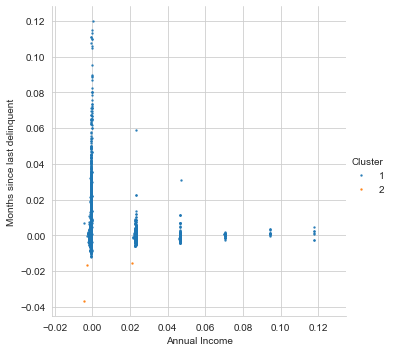

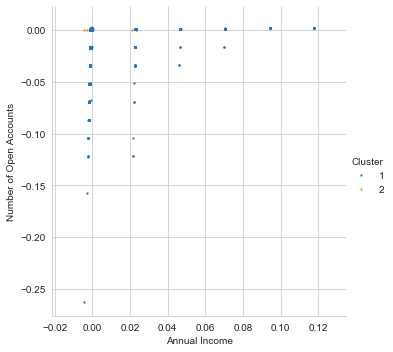

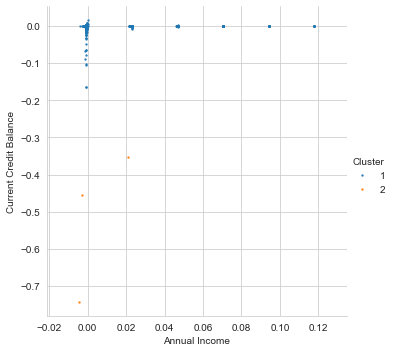

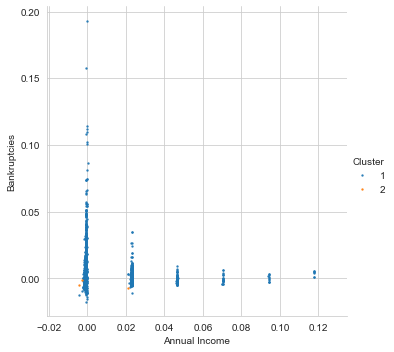

...

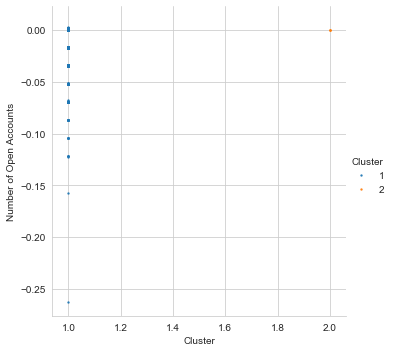

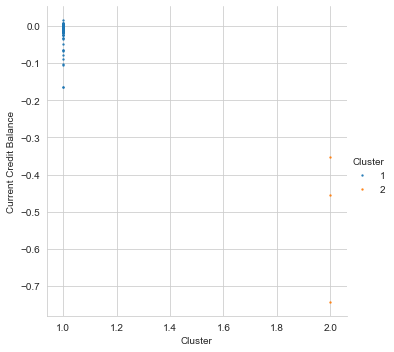

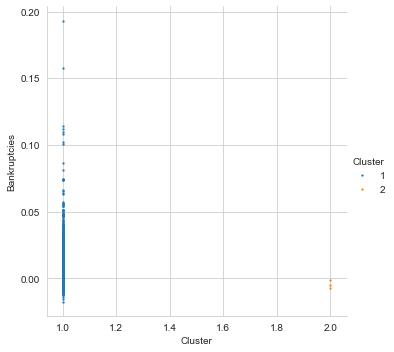

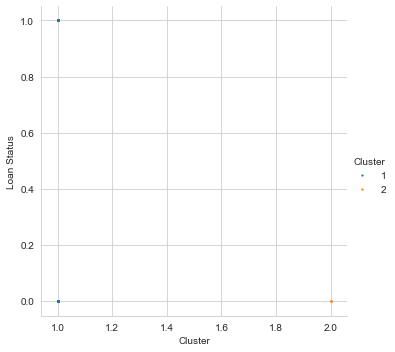

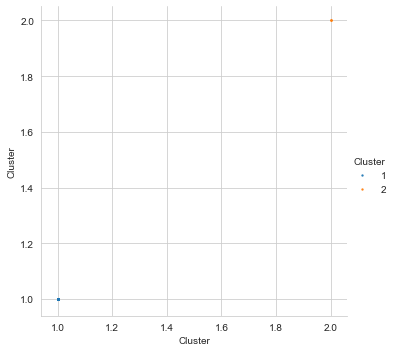

In [98]:
for i in ica_km_df.columns:
    for j in ica_km_df.columns:
        sns.lmplot(data=ica_km_df, x=i, y=j,hue='Cluster',fit_reg=False, legend=True, scatter_kws={"s": 2},legend_out=True)
        plt.show()

In [99]:
#ICA EM

In [100]:
ica_em_sil_score = []
for k in range(2,10):
    gmm = GMM(n_components=k).fit(ica_df_final)
    ica_gmm_pred_y = gmm.predict(ica_df_final)
    ica_em_sil_score.append(silhouette_score( ica_df_final,ica_gmm_pred_y ))

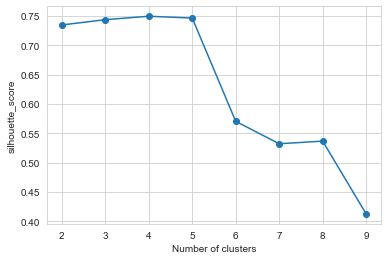

In [101]:
plt.plot(range(2, 10), ica_em_sil_score,marker ='o')
# plt.title('Elbow Method')
plt.xlabel('Number of clusters')
sns.set_style("whitegrid")
plt.ylabel('silhouette_score')
plt.show()

In [102]:
ica_gmm = GMM(n_components=4).fit(ica_df_final)
ica_em_pred_y = ica_gmm.predict(ica_df_final)
ica_em_pred_y = ica_em_pred_y+1
ica_em_pred_y =pd.DataFrame(ica_em_pred_y,columns=['Cluster'])
ica_em_df = pd.concat([ica_df_final,y,ica_em_pred_y],axis=1)

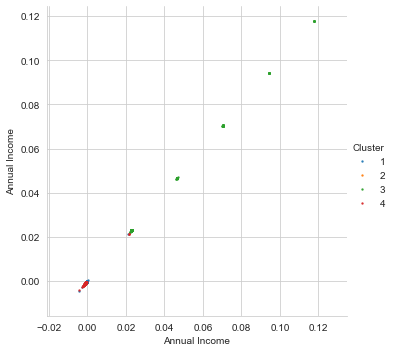

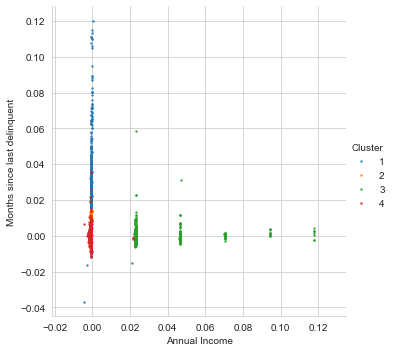

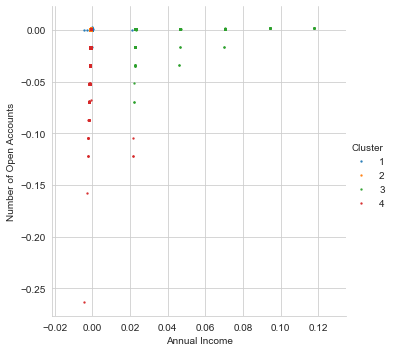

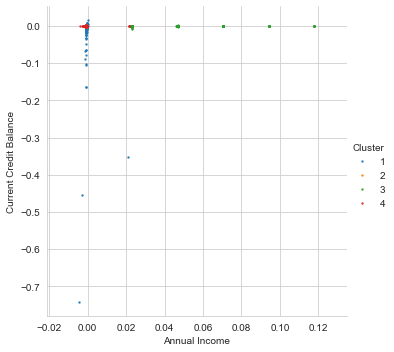

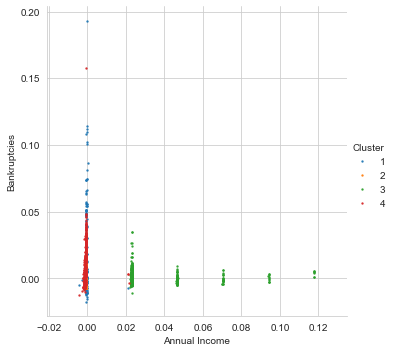

...

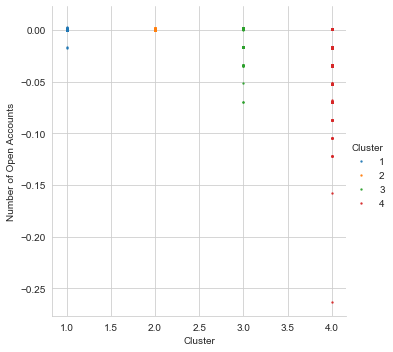

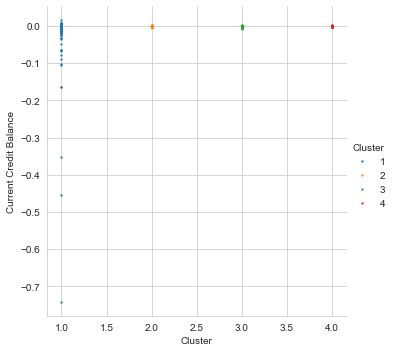

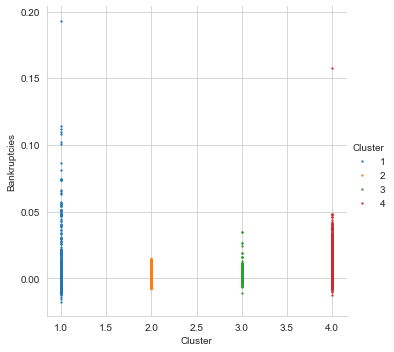

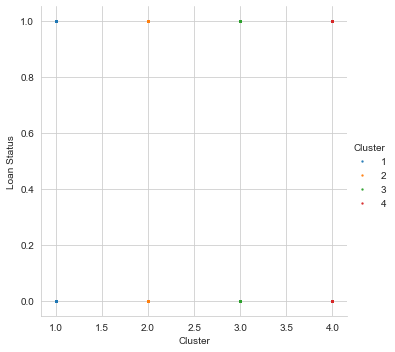

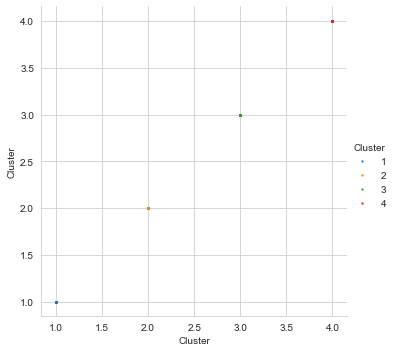

In [103]:
for i in ica_em_df.columns:
    for j in ica_em_df.columns:
        sns.lmplot(data=ica_em_df, x=i, y=j,hue='Cluster',fit_reg=False, legend=True, scatter_kws={"s": 2},legend_out=True)
        plt.show()

In [ ]:
# RO KM

In [104]:
ro_km_sil_score = []
for k in range(2,10):
    kmeans = KMeans( n_clusters=k,n_init=100 ).fit(ro_df)
    pred_y = kmeans.fit_predict(ro_df)
    ro_km_sil_score.append(silhouette_score( ro_df,pred_y ))

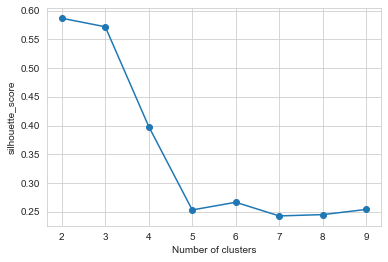

In [105]:
plt.plot(range(2, 10), ro_km_sil_score,marker ='o')
# plt.title('Elbow Method')
plt.xlabel('Number of clusters')
sns.set_style("whitegrid")
plt.ylabel('silhouette_score')
plt.show()

In [106]:
ro_kmeans = KMeans(n_clusters=2, init='k-means++', max_iter=300, n_init=10, random_state=0)
ro_pred_y = ro_kmeans.fit_predict(ro_df)
ro_pred_y = ro_pred_y+1
ro_pred_y =pd.DataFrame(ro_pred_y,columns=['Cluster'])
pca_km_df = pd.concat([ro_df,y,ro_pred_y],axis=1)

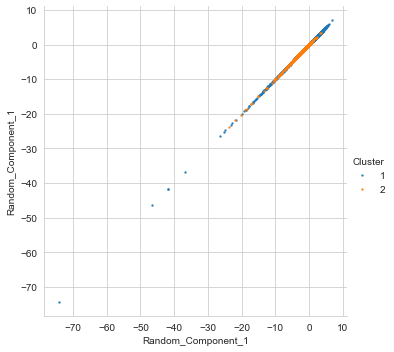

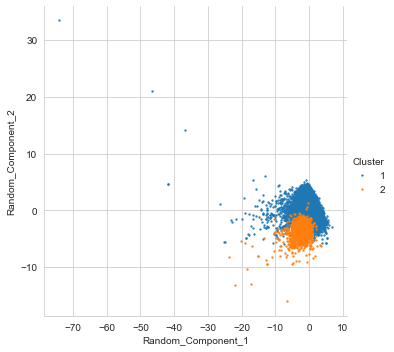

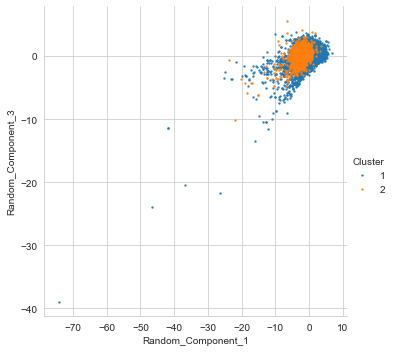

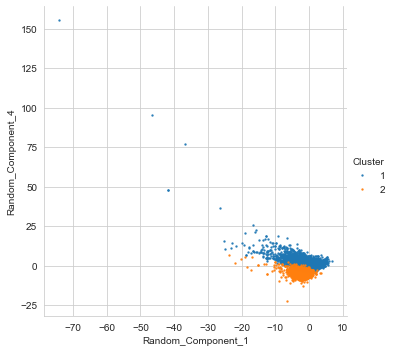

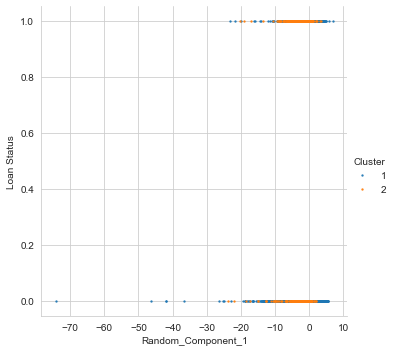

...

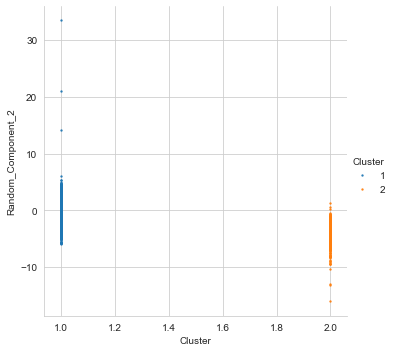

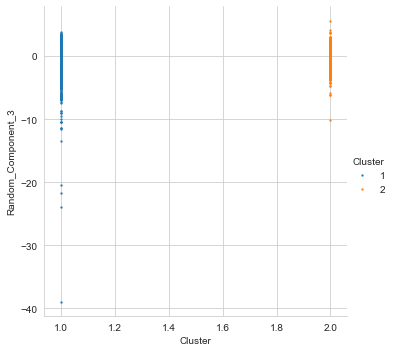

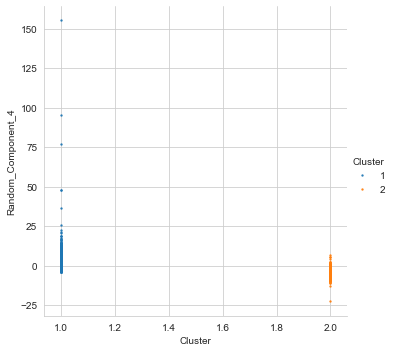

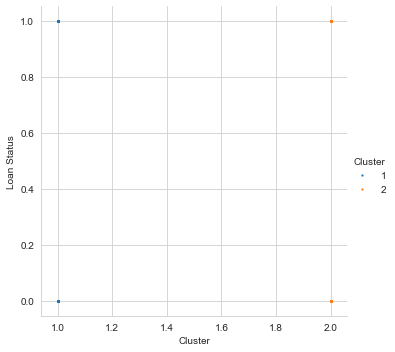

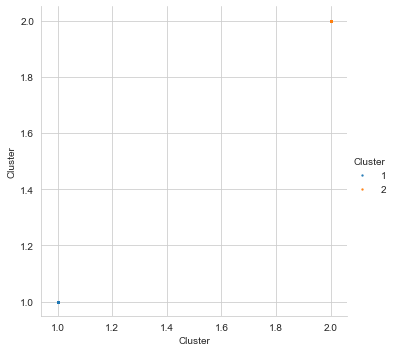

In [107]:
for i in pca_km_df.columns:
    for j in pca_km_df.columns:
        sns.lmplot(data=pca_km_df, x=i, y=j,hue='Cluster',fit_reg=False, legend=True, scatter_kws={"s": 2},legend_out=True)
        plt.show()

In [108]:
#RO EX MAX

In [109]:
ro_em_sil_score = []
for k in range(2,10):
    gmm = GMM(n_components=k).fit(ro_df)
    ro_gmm_pred_y = gmm.predict(ro_df)
    ro_em_sil_score.append(silhouette_score( ro_df,ro_gmm_pred_y ))

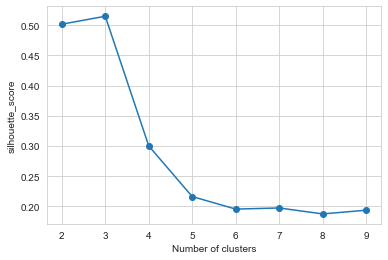

In [110]:
plt.plot(range(2, 10), ro_em_sil_score,marker ='o')
# plt.title('Elbow Method')
plt.xlabel('Number of clusters')
sns.set_style("whitegrid")
plt.ylabel('silhouette_score')
plt.show()

In [111]:
ro_gmm = GMM(n_components=3).fit(ro_df)
ro_em_pred_y = ro_gmm.predict(ro_df)
ro_em_pred_y = ro_em_pred_y+1
ro_em_pred_y =pd.DataFrame(ro_em_pred_y,columns=['Cluster'])
ro_em_df = pd.concat([ro_df,y,ro_em_pred_y],axis=1)

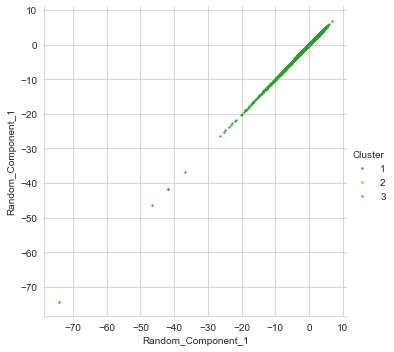

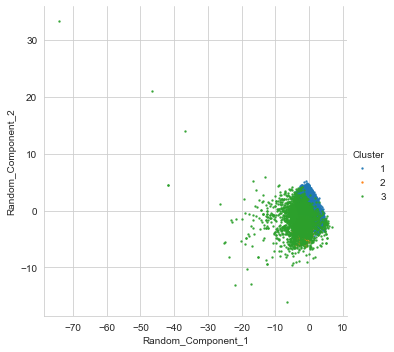

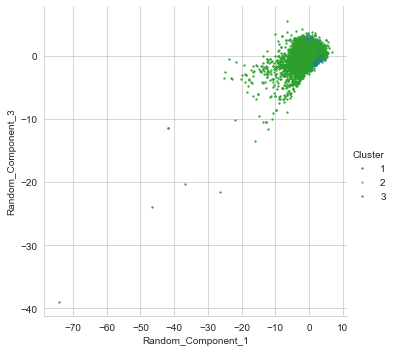

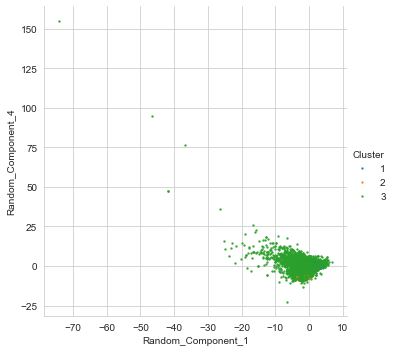

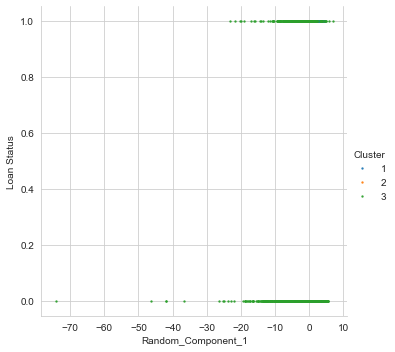

...

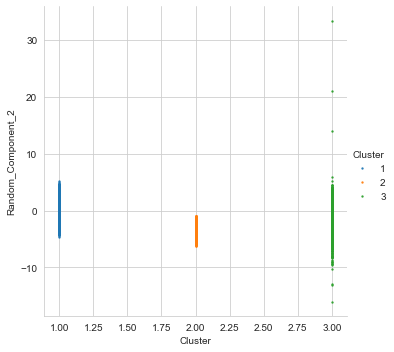

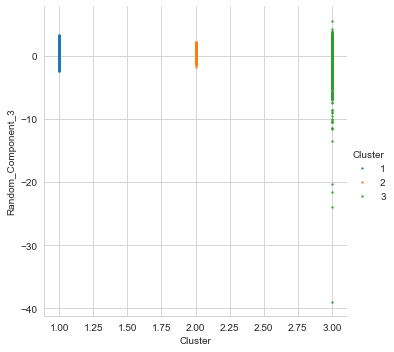

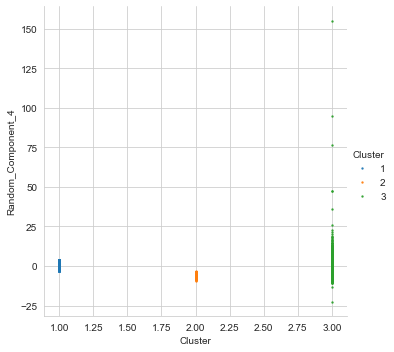

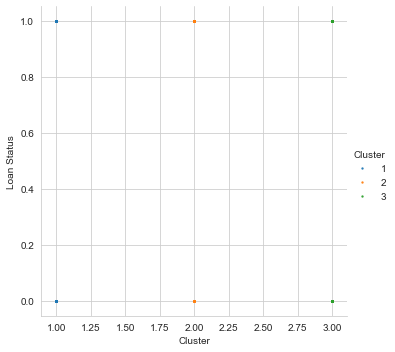

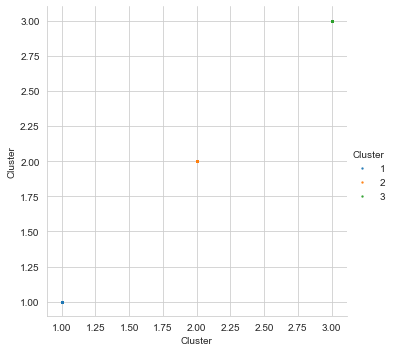

In [112]:
for i in ro_em_df.columns:
    for j in ro_em_df.columns:
        sns.lmplot(data=ro_em_df, x=i, y=j,hue='Cluster',fit_reg=False, legend=True, scatter_kws={"s": 2},legend_out=True)
        plt.show()

### Undersampling 

In [115]:
def undersampling(x_train,y_train):
    y_train =pd.DataFrame(y_train)
    x_train = pd.DataFrame(x_train)
    un_samp_train = x_train
    un_samp_train['Loan Status'] = [x for x in y_train['Loan Status']]
    fp =un_samp_train[un_samp_train['Loan Status']== 0].sample(7000,axis=0,random_state = 33)
    co =un_samp_train[un_samp_train['Loan Status']== 1]
    s_train = pd.concat([fp,co],axis=0)
    y_s_train_def = s_train['Loan Status']
    x_s_train_def = s_train.loc[:, s_train.columns != 'Loan Status']
    return x_s_train_def,y_s_train_def

In [ ]:
#### Under Sampling the data to have a better model

In [128]:
# un_samp_train = x_train

In [135]:
# un_samp_train['Loan Status'] = [x for x in y_train['Loan Status']]

In [130]:
# fp =un_samp_train[un_samp_train['Loan Status']== 0].sample(7000,axis=0,random_state = 33)

In [131]:
# co =un_samp_train[un_samp_train['Loan Status']== 1]

In [132]:
# s_train = pd.concat([fp,co],axis=0)

In [ ]:
## Final Train Sets for X and Y

In [133]:
# y_s_train = s_train['Loan Status']
# x_s_train = s_train.loc[:, s_train.columns != 'Loan Status']

In [ ]:
# Copying the train and test

In [28]:
# mlp_x_train = x_s_train.copy()
# mlp_y_train = y_s_train.copy()
# mlp_x_test = x_test.copy()
# mlp_y_test = y_test.copy()

# DT ANN

In [138]:
dt_x_train_us, dt_x_test, dt_y_train_us, dt_y_test = train_test_split(dt_df,y,test_size=0.3,random_state=33)
dt_x_train, dt_y_train = undersampling(dt_x_train_us,dt_y_train_us)

# Experimenting with both Neurons and Layers

In [149]:

#### Combination of Neurons and Layers
optimizer_value = keras.optimizers.Adam(learning_rate=0.01)
neurons_list = [2,4,6]
layers_combo = [2,3,4]
acc_list = []
dt_acc_df = pd.DataFrame()
for layer_no in layers_combo:
    print("The Number of layers:",layer_no)
    neurons_combo = [p for p in itertools.product(neurons_list, repeat=layer_no)]
    for neurons in neurons_combo:
        print("The tuple of Neurons:",neurons)
        model = Sequential()
        for layer in range(1,layer_no+1):
            if (layer == 1):
                model.add(Dense(neurons[0], input_dim=6, activation='sigmoid'))
            else:
                model.add(Dense(neurons[layer-1],activation='sigmoid'))
        model.add(Dense(1, activation='sigmoid'))
        model.compile(optimizer=optimizer_value, loss='binary_crossentropy')
        model.fit(dt_x_train, dt_y_train, epochs=25,batch_size=200)
        pred = model.predict_classes(dt_x_test)
        acc = f1_score(dt_y_test,pred)
        acc_values  =  [acc,layer_no,neurons]
        acc_values = pd.DataFrame(acc_values).T
        dt_acc_df = pd.concat([dt_acc_df,acc_values])

dt_acc_df.columns = ['F1Score','LayerNumber','Neurons']
dt_acc_df = dt_acc_df.sort_values(by='F1Score', ascending = False)
dt_acc_df_head = dt_acc_df.head(10)
dt_acc_df_head

The Number of layers: 2
The tuple of Neurons: (2, 2)
Epoch 1/25
12194/12194 [==============================] - 0s 14us/step - loss: 0.6780
Epoch 2/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6481
Epoch 3/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5984
Epoch 4/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5689
Epoch 5/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5563
Epoch 6/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5499
Epoch 7/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5456
Epoch 8/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5430
Epoch 9/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5403
Epoch 10/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5392
Epoch 11/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5384
Epoch 12/

12194/12194 [==============================] - 0s 6us/step - loss: 0.5280
Epoch 20/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5285
Epoch 21/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5283
Epoch 22/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5286
Epoch 23/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5273
Epoch 24/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5280
Epoch 25/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5275
The tuple of Neurons: (4, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 14us/step - loss: 0.6118
Epoch 2/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5433
Epoch 3/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5368
Epoch 4/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5353
Epoch 5/25
12194/12194 [================

12194/12194 [==============================] - 0s 6us/step - loss: 0.5299
Epoch 14/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5280
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5280
Epoch 16/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5276
Epoch 17/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5294
Epoch 18/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5273
Epoch 19/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5277
Epoch 20/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5273
Epoch 21/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5267
Epoch 22/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5265
Epoch 23/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5269
Epoch 24/25
12194/12194 [==============================] - 0s 6us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5374
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5373
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5368
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5355
Epoch 11/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5343
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5328
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5314
Epoch 14/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5346
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5334
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5327
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5321
Epoch 18/25
12194/12194 [==============================] - 0s 6us/st

Epoch 1/25
12194/12194 [==============================] - 0s 14us/step - loss: 0.6817
Epoch 2/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6044
Epoch 3/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5699
Epoch 4/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5593
Epoch 5/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5524
Epoch 6/25
12194/12194 [==============================] - 0s 5us/step - loss: 0.5494
Epoch 7/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5430
Epoch 8/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5420
Epoch 9/25
12194/12194 [==============================] - 0s 5us/step - loss: 0.5388
Epoch 10/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5355
Epoch 11/25
12194/12194 [==============================] - 0s 5us/step - loss: 0.5348
Epoch 12/25
12194/12194 [==============================] - 0s 

12194/12194 [==============================] - 0s 6us/step - loss: 0.5284
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5285
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5276
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5273
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5283
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5270
The tuple of Neurons: (4, 2, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 16us/step - loss: 0.6249
Epoch 2/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5593
Epoch 3/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5503
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5420
Epoch 5/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5398
Epoch 6/25
12194/12194 [==============

12194/12194 [==============================] - 0s 7us/step - loss: 0.5304
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5304
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5301
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5294
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5299
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5292
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5281
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5282
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5294
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5296
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5279
Epoch 25/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5359
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5313
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5317
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5293
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5290
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5284
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5298
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5301
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5277
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5291
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5276
Epoch 19/25
12194/12194 [==============================] - 0s 7us/s

12194/12194 [==============================] - 0s 6us/step - loss: 0.6308
Epoch 3/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5804
Epoch 4/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5678
Epoch 5/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5594
Epoch 6/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5540
Epoch 7/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5474
Epoch 8/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5427
Epoch 9/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5391
Epoch 10/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5374
Epoch 11/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5382
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5346
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - 

12194/12194 [==============================] - 0s 6us/step - loss: 0.5308
Epoch 22/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5300
Epoch 23/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5292
Epoch 24/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5292
Epoch 25/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5289
The tuple of Neurons: (6, 6, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 15us/step - loss: 0.6115
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5507
Epoch 3/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5434
Epoch 4/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5387
Epoch 5/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5361
Epoch 6/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5373
Epoch 7/25
12194/12194 [===============

12194/12194 [==============================] - 0s 7us/step - loss: 0.5333
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5326
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5344
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5321
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5302
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5328
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5324
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5299
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5309
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5311
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5298
Epoch 25/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5372
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5414
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5375
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5357
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5338
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5318
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5336
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5331
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5341
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5331
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5351
Epoch 19/25
12194/12194 [==============================] - 0s 7us/s

12194/12194 [==============================] - 0s 6us/step - loss: 0.5870
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5665
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5593
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5528
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5463
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5429
Epoch 8/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5415
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5392
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5381
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5346
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5362
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - 

12194/12194 [==============================] - 0s 6us/step - loss: 0.5317
Epoch 22/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5317
Epoch 23/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5309
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5305
Epoch 25/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5305
The tuple of Neurons: (2, 4, 4, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 17us/step - loss: 0.6535
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5674
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5622
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5516
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5488
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5430
Epoch 7/25
12194/12194 [============

12194/12194 [==============================] - 0s 7us/step - loss: 0.5288
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5286
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5288
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5289
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5288
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5282
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5277
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5276
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5275
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5298
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5281
The tuple of Neurons: (2, 4, 6, 6)
Epoch 1/25
12194/12194 [=======

12194/12194 [==============================] - 0s 6us/step - loss: 0.5379
Epoch 10/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5382
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5385
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5361
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5360
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5355
Epoch 15/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5339
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5335
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5341
Epoch 18/25
12194/12194 [==============================] - 0s 5us/step - loss: 0.5325
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5327
Epoch 20/25
12194/12194 [==============================] - 0s 6us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.6113
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5930
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5801
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5649
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5549
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5514
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5439
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5412
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5394
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5373
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5365
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step -

12194/12194 [==============================] - 0s 7us/step - loss: 0.5319
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5303
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5299
Epoch 25/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5295
The tuple of Neurons: (4, 2, 2, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6929
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6670
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5912
Epoch 4/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5696
Epoch 5/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5640
Epoch 6/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5583
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5524
Epoch 8/25
12194/12194 [=============

12194/12194 [==============================] - 0s 7us/step - loss: 0.5285
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5298
Epoch 18/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5279
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5300
Epoch 20/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5276
Epoch 21/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5273
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5273
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5274
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5268
Epoch 25/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5271
The tuple of Neurons: (4, 2, 4, 6)
Epoch 1/25
12194/12194 [==============================] - 0s 17us/step - loss: 0.6481
Epoch 2/25
12194/12194 [=======

12194/12194 [==============================] - 0s 7us/step - loss: 0.5424
Epoch 10/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5375
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5370
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5333
Epoch 13/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5333
Epoch 14/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5326
Epoch 15/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5313
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5302
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5300
Epoch 18/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5309
Epoch 19/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5291
Epoch 20/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.6261
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5943
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5796
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5716
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5601
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5530
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5471
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5441
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5406
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5409
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5388
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - 

12194/12194 [==============================] - 0s 6us/step - loss: 0.5307
Epoch 22/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5304
Epoch 23/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5309
Epoch 24/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5300
Epoch 25/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5307
The tuple of Neurons: (4, 4, 6, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6335
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5610
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5504
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5431
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5436
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5377
Epoch 7/25
12194/12194 [============

12194/12194 [==============================] - 0s 7us/step - loss: 0.5303
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5299
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5300
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5307
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5296
Epoch 20/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5283
Epoch 21/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5289
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5299
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5293
Epoch 24/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5309
Epoch 25/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5280
The tuple of Neurons: (4, 6, 2, 6)
Epoch 1/25
12194/12194 [=======

12194/12194 [==============================] - 0s 7us/step - loss: 0.5321
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5323
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5296
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5296
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5294
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5290
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5285
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5271
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5279
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5273
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5295
Epoch 20/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5708
Epoch 4/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5572
Epoch 5/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5478
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5414
Epoch 7/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5377
Epoch 8/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5348
Epoch 9/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5343
Epoch 10/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5329
Epoch 11/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5321
Epoch 12/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5324
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5311
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step -

12194/12194 [==============================] - 0s 6us/step - loss: 0.5294
Epoch 23/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5277
Epoch 24/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5277
Epoch 25/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5285
The tuple of Neurons: (6, 2, 4, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6930
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6827
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6821
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6807
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6469
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6158
Epoch 8/25
12194/12194 [=============

12194/12194 [==============================] - 0s 7us/step - loss: 0.5345
Epoch 17/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5329
Epoch 18/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5331
Epoch 19/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5343
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5327
Epoch 21/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5351
Epoch 22/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5326
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5317
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5312
Epoch 25/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5348
The tuple of Neurons: (6, 2, 6, 6)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6340
Epoch 2/25
12194/12194 [=======

12194/12194 [==============================] - 0s 7us/step - loss: 0.5323
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5322
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5306
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5288
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5290
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5283
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5276
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5276
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5277
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5265
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5271
Epoch 21/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5588
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5461
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5429
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5372
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5359
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5343
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5333
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5336
Epoch 11/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5325
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5309
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5308
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step -

12194/12194 [==============================] - 0s 6us/step - loss: 0.5289
Epoch 23/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5288
Epoch 24/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5294
Epoch 25/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5289
The tuple of Neurons: (6, 6, 2, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6887
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6423
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5782
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5513
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5397
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5356
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5331
Epoch 8/25
12194/12194 [=============

12194/12194 [==============================] - 0s 7us/step - loss: 0.5271
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5274
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5268
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5281
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5273
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5274
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5276
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5266
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5270
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5277
The tuple of Neurons: (6, 6, 4, 6)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6577
Epoch 2/25
12194/12194 [=======

12194/12194 [==============================] - 0s 7us/step - loss: 0.5283
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5289
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5287
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5292
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5276
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5272
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5268
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5259
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5274
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5266
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5271
Epoch 20/25
12194/12194 [==============================] - 0s 7us/

,F1Score,LayerNumber,Neurons
0,0.441202,4,"(6, 2, 2, 6)"
0,0.439907,4,"(4, 6, 2, 6)"
0,0.439099,4,"(4, 2, 2, 6)"
0,0.438946,4,"(6, 4, 6, 2)"
0,0.4375,4,"(4, 2, 6, 2)"
0,0.435011,4,"(4, 4, 4, 2)"
0,0.433231,4,"(2, 2, 6, 4)"
0,0.431764,4,"(2, 4, 2, 6)"
0,0.429777,4,"(4, 6, 6, 4)"
0,0.428967,3,"(4, 4, 4)"


Text(0.5, 1.0, 'F1 Score vs Neurons vs Layers')

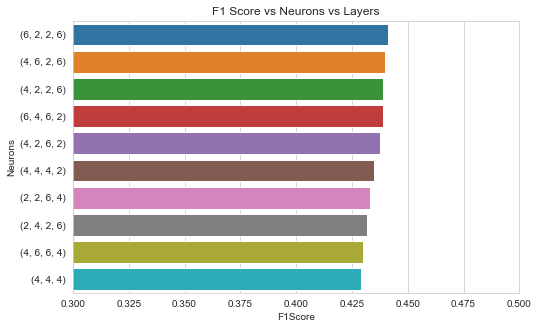

In [161]:
flatui = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c"]
plt.figure(figsize=(8, 5))
g =sns.barplot(data=dt_acc_df_head ,x='F1Score', y='Neurons',orient ="h")
g.set(xlim=(0.3, 0.5))
sns.set_style("whitegrid")
plt.title("F1 Score vs Neurons vs Layers")

# Final Model with Best Attributes

In [285]:
from keras import backend as K
optimizer_value = keras.optimizers.Adam(learning_rate=0.01)
def recall_m(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
        recall = true_positives / (possible_positives + K.epsilon())
        return recall

def precision_m(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
        precision = true_positives / (predicted_positives + K.epsilon())
        return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))


model = Sequential()
model.add(Dense(6, input_dim=6, activation='sigmoid'))
model.add(Dense(2, activation='sigmoid'))
model.add(Dense(2, activation='sigmoid'))
model.add(Dense(6, activation='sigmoid'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam', metrics=['acc',f1_m,precision_m, recall_m])

# Train_model

# Fit the model
model.fit(dt_x_train, dt_y_train, epochs=100,batch_size = 200,verbose=0)
pred_train = model.predict_classes(dt_x_train)
# print(scores_final_train)
print("Train Classification Report")
print(classification_report(dt_y_train,pred_train))
print('')
print("F-1 Score")
print(f1_score(dt_y_train,pred_train))
print('')
print("      Confusion Matrix")
print(pd.DataFrame(confusion_matrix(dt_y_train,pred_train),index=['Actual 0','Actual 1'],columns=['Predicted 0','Predicted 1']))

#------------------------------------------------------------------------------------------------#


model = Sequential()
model.add(Dense(6, input_dim=6, activation='sigmoid'))
model.add(Dense(2, activation='sigmoid'))
model.add(Dense(2, activation='sigmoid'))
model.add(Dense(6, activation='sigmoid'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam')

# Fit the Model
model.fit(dt_x_train, dt_y_train, epochs=100,batch_size = 200,verbose=0)

# print("Test Measures")
# print(scores_final_test)
pred_test = model.predict_classes(dt_x_test)
print("Test Classification Report")
print(classification_report(dt_y_test,pred_test))
print('')
print("F-1 Score")
print(f1_score(dt_y_test,pred_test))
print('')
print("      Confusion Matrix")
print(pd.DataFrame(confusion_matrix(dt_y_test,pred_test),index=['Actual 0','Actual 1'],columns=['Predicted 0','Predicted 1']))


Train Classification Report
              precision    recall  f1-score   support

           0       0.65      0.99      0.78      7000
           1       0.96      0.28      0.43      5194

    accuracy                           0.69     12194
   macro avg       0.80      0.63      0.61     12194
weighted avg       0.78      0.69      0.63     12194


F-1 Score
0.42891278375149344

      Confusion Matrix
          Predicted 0  Predicted 1
Actual 0         6934           66
Actual 1         3758         1436
Test Classification Report
              precision    recall  f1-score   support

           0       0.84      0.96      0.89      8670
           1       0.64      0.30      0.41      2257

    accuracy                           0.82     10927
   macro avg       0.74      0.63      0.65     10927
weighted avg       0.80      0.82      0.79     10927


F-1 Score
0.4091593853570352

      Confusion Matrix
          Predicted 0  Predicted 1
Actual 0         8287          383
Actual 

dict_keys(['val_loss', 'val_acc', 'val_f1_m', 'val_precision_m', 'val_recall_m', 'loss', 'acc', 'f1_m', 'precision_m', 'recall_m'])


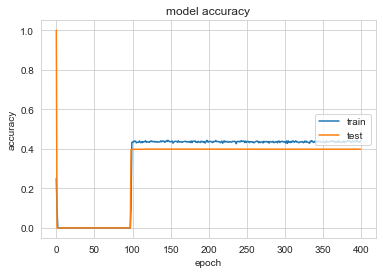

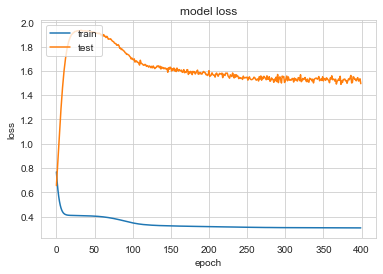

In [286]:
#Learing Curve with Epochs
model = Sequential()
model.add(Dense(6, input_dim=6, activation='sigmoid'))
model.add(Dense(2, activation='sigmoid'))
model.add(Dense(2, activation='sigmoid'))
model.add(Dense(6, activation='sigmoid'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam', metrics=['acc',f1_m,precision_m, recall_m])
# Fit the model
history = model.fit(dt_x_train, dt_y_train,validation_split=0.33, epochs=400,batch_size = 200,verbose=0)
# list all data in history
print(history.history.keys())
# summarize history for accuracy
plt.plot(history.history['f1_m'])
plt.plot(history.history['val_f1_m'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='center right')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [ ]:
# ANN PCA

In [289]:
pca_x_train_us, pca_x_test, pca_y_train_us, pca_y_test = train_test_split(pca_df,y,test_size=0.3,random_state=33)
pca_x_train, pca_y_train = undersampling(pca_x_train_us,pca_y_train_us)

In [166]:
#### Combination of Neurons and Layers
optimizer_value = keras.optimizers.Adam(learning_rate=0.01)
neurons_list = [4,6,8,10]
layers_combo = [2,3,4]
acc_list = []
pca_acc_df = pd.DataFrame()
for layer_no in layers_combo:
    print("The Number of layers:",layer_no)
    neurons_combo = [p for p in itertools.product(neurons_list, repeat=layer_no)]
    for neurons in neurons_combo:
        print("The tuple of Neurons:",neurons)
        model = Sequential()
        for layer in range(1,layer_no+1):
            if (layer == 1):
                model.add(Dense(neurons[0], input_dim=10, activation='sigmoid'))
            else:
                model.add(Dense(neurons[layer-1],activation='sigmoid'))
        model.add(Dense(1, activation='sigmoid'))
        model.compile(optimizer=optimizer_value, loss='binary_crossentropy')
        model.fit(pca_x_train, pca_y_train, epochs=25,batch_size=200)
        pred = model.predict_classes(pca_x_test)
        acc = f1_score(pca_y_test,pred)
        acc_values  =  [acc,layer_no,neurons]
        acc_values = pd.DataFrame(acc_values).T
        pca_acc_df = pd.concat([pca_acc_df,acc_values])

pca_acc_df.columns = ['F1Score','LayerNumber','Neurons']
pca_acc_df = pca_acc_df.sort_values(by='F1Score', ascending = False)
pca_acc_df_head = pca_acc_df.head(10)
pca_acc_df_head

The Number of layers: 2
The tuple of Neurons: (4, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 14us/step - loss: 0.6749
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6114
Epoch 3/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5713
Epoch 4/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5555
Epoch 5/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5481
Epoch 6/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5442
Epoch 7/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5426
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5411
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5399
Epoch 10/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5387
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5363
Epoch 12/

Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5292
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5294
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5293
Epoch 23/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5302
Epoch 24/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5296
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5294
The tuple of Neurons: (6, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 15us/step - loss: 0.6231
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5591
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5481
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5434
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5420
Epoch 6/25
12194/12194 [=====

12194/12194 [==============================] - 0s 7us/step - loss: 0.5325
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5313
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5303
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5321
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5311
Epoch 19/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5313
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5311
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5302
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5317
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5313
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5319
Epoch 25/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 6us/step - loss: 0.5340
Epoch 9/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5335
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5335
Epoch 11/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5346
Epoch 12/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5324
Epoch 13/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5309
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5316
Epoch 15/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5304
Epoch 16/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5294
Epoch 17/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5293
Epoch 18/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5286
Epoch 19/25
12194/12194 [==============================] - 0s 7us/s

12194/12194 [==============================] - 0s 6us/step - loss: 0.5386
Epoch 3/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5338
Epoch 4/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5318
Epoch 5/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5297
Epoch 6/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5295
Epoch 7/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5287
Epoch 8/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5282
Epoch 9/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5277
Epoch 10/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5278
Epoch 11/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5266
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5271
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - 

12194/12194 [==============================] - 0s 7us/step - loss: 0.5324
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5314
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5308
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5297
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5300
The tuple of Neurons: (4, 4, 10)
Epoch 1/25
12194/12194 [==============================] - 0s 17us/step - loss: 0.6453
Epoch 2/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5600
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5425
Epoch 4/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5399
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5348
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5338
Epoch 7/25
12194/12194 [==============

12194/12194 [==============================] - 0s 6us/step - loss: 0.5344
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5351
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5328
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5348
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5328
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5318
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5333
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5321
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5325
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5324
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5307
The tuple of Neurons: (4, 6, 10)
Epoch 1/25
12194/12194 [=========

12194/12194 [==============================] - 0s 7us/step - loss: 0.5339
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5329
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5334
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5326
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5339
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5320
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5301
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5324
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5306
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5313
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5315
Epoch 20/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5513
Epoch 4/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5435
Epoch 5/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5412
Epoch 6/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5378
Epoch 7/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5368
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5362
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5356
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5336
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5336
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5328
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5328
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step -

12194/12194 [==============================] - 0s 6us/step - loss: 0.5273
Epoch 23/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5266
Epoch 24/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5268
Epoch 25/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5264
The tuple of Neurons: (6, 4, 8)
Epoch 1/25
12194/12194 [==============================] - 0s 17us/step - loss: 0.6252
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5564
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5429
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5420
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5383
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5358
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5340
Epoch 8/25
12194/12194 [================

12194/12194 [==============================] - 0s 7us/step - loss: 0.5265
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5265
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5264
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5263
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5266
Epoch 21/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5254
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5258
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5256
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5262
Epoch 25/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5256
The tuple of Neurons: (6, 6, 8)
Epoch 1/25
12194/12194 [==============================] - 0s 17us/step - loss: 0.6246
Epoch 2/25
12194/12194 [==========

12194/12194 [==============================] - 0s 7us/step - loss: 0.5320
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5316
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5320
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5297
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5305
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5300
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5293
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5294
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5295
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5293
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5292
Epoch 21/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5359
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5319
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5303
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5287
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5280
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5278
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5271
Epoch 11/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5266
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5272
Epoch 13/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5266
Epoch 14/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5266
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step 

12194/12194 [==============================] - 0s 7us/step - loss: 0.5249
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5250
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5253
The tuple of Neurons: (8, 4, 6)
Epoch 1/25
12194/12194 [==============================] - 0s 16us/step - loss: 0.6081
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5514
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5446
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5390
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5373
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5350
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5372
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5316
Epoch 9/25
12194/12194 [=================

12194/12194 [==============================] - 0s 7us/step - loss: 0.5287
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5274
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5276
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5266
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5290
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5266
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5259
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5258
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5262
The tuple of Neurons: (8, 6, 6)
Epoch 1/25
12194/12194 [==============================] - 0s 16us/step - loss: 0.6018
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5523
Epoch 3/25
12194/12194 [===========

12194/12194 [==============================] - 0s 7us/step - loss: 0.5280
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5275
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5273
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5271
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5271
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5275
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5263
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5268
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5265
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5259
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5262
Epoch 22/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5731
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5618
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5541
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5494
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5446
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5420
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5395
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5373
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5377
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5350
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5341
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step 

12194/12194 [==============================] - 0s 7us/step - loss: 0.5259
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5255
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5263
The tuple of Neurons: (10, 4, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 16us/step - loss: 0.5970
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5545
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5427
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5392
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5354
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5320
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5312
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5298
Epoch 9/25
12194/12194 [================

12194/12194 [==============================] - 0s 7us/step - loss: 0.5264
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5260
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5257
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5261
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5262
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5256
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5250
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5249
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5251
The tuple of Neurons: (10, 6, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 16us/step - loss: 0.6280
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5535
Epoch 3/25
12194/12194 [==========

12194/12194 [==============================] - 0s 6us/step - loss: 0.5292
Epoch 12/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5273
Epoch 13/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5279
Epoch 14/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5261
Epoch 15/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5269
Epoch 16/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5274
Epoch 17/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5261
Epoch 18/25
12194/12194 [==============================] - 0s 5us/step - loss: 0.5257
Epoch 19/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5257
Epoch 20/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5253
Epoch 21/25
12194/12194 [==============================] - 0s 5us/step - loss: 0.5257
Epoch 22/25
12194/12194 [==============================] - 0s 6us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5342
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5341
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5304
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5294
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5294
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5291
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5279
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5288
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5271
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5270
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5269
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step

12194/12194 [==============================] - 0s 7us/step - loss: 0.5256
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5258
The tuple of Neurons: (10, 10, 10)
Epoch 1/25
12194/12194 [==============================] - 0s 17us/step - loss: 0.6798
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5778
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5555
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5445
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5393
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5394
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5344
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5332
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5317
Epoch 10/25
12194/12194 [==============

12194/12194 [==============================] - 0s 7us/step - loss: 0.5350
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5330
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5354
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5324
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5322
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5318
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5328
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5317
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5299
The tuple of Neurons: (4, 4, 4, 10)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6187
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5578
Epoch 3/25
12194/12194 [=======

12194/12194 [==============================] - 0s 8us/step - loss: 0.5328
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5355
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5344
Epoch 14/25
12194/12194 [==============================] - 0s 10us/step - loss: 0.5318
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5316
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5323
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5332
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5313
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5313
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5309
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5299
Epoch 22/25
12194/12194 [==============================] - 0s 8us

12194/12194 [==============================] - 0s 8us/step - loss: 0.5413
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5381
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5365
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5331
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5335
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5330
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5348
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5323
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5316
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5313
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5316
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step

12194/12194 [==============================] - 0s 8us/step - loss: 0.5307
Epoch 25/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5317
The tuple of Neurons: (4, 4, 10, 8)
Epoch 1/25
12194/12194 [==============================] - 0s 20us/step - loss: 0.6246
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5622
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5508
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5466
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5429
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5390
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5379
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5361
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5346
Epoch 10/25
12194/12194 [=============

12194/12194 [==============================] - 0s 8us/step - loss: 0.5297
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5296
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5296
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5286
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5301
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5288
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5299
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5284
The tuple of Neurons: (4, 6, 4, 8)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6297
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5661
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5543
Epoch 4/25
12194/12194 [=========

12194/12194 [==============================] - 0s 7us/step - loss: 0.5329
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5313
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5306
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5324
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5306
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5299
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5291
Epoch 19/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5294
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5301
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5297
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5280
Epoch 23/25
12194/12194 [==============================] - 0s 6us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5379
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5347
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5361
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5347
Epoch 10/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5312
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5304
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5300
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5305
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5303
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5298
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5287
Epoch 17/25
12194/12194 [==============================] - 0s 7us/ste

12194/12194 [==============================] - 0s 7us/step - loss: 0.5278
The tuple of Neurons: (4, 6, 10, 6)
Epoch 1/25
12194/12194 [==============================] - 0s 20us/step - loss: 0.6475
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5701
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5605
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5555
Epoch 5/25
12194/12194 [==============================] - 0s 10us/step - loss: 0.5467
Epoch 6/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5426
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5392
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5380
Epoch 9/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5346
Epoch 10/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5365
Epoch 11/25
12194/12194 [============

12194/12194 [==============================] - 0s 8us/step - loss: 0.5276
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5270
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5273
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5268
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5277
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5274
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5270
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5264
The tuple of Neurons: (4, 8, 4, 6)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6606
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5810
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5704
Epoch 4/25
12194/12194 [=========

12194/12194 [==============================] - 0s 8us/step - loss: 0.5333
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5317
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5321
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5304
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5312
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5298
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5306
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5296
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5293
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5289
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5288
Epoch 23/25
12194/12194 [==============================] - 0s 8us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5475
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5397
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5396
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5382
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5373
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5343
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5335
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5323
Epoch 13/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5311
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5316
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5308
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step

12194/12194 [==============================] - 0s 9us/step - loss: 0.5302
Epoch 25/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5288
The tuple of Neurons: (4, 8, 10, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6281
Epoch 2/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5688
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5623
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5485
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5468
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5408
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5400
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5378
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5350
Epoch 10/25
12194/12194 [=============

12194/12194 [==============================] - 0s 7us/step - loss: 0.5275
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5272
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5274
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5285
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5273
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5269
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5272
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5260
The tuple of Neurons: (4, 10, 4, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.7002
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6820
Epoch 4/25
12194/12194 [========

12194/12194 [==============================] - 0s 7us/step - loss: 0.5329
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5302
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5340
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5302
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5298
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5297
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5309
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5300
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5317
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5283
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5285
Epoch 23/25
12194/12194 [==============================] - 0s 8us/

12194/12194 [==============================] - 0s 8us/step - loss: 0.5336
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5320
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5309
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5301
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5307
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5297
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5291
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5290
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5293
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5302
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5283
Epoch 17/25
12194/12194 [==============================] - 0s 7us/ste

12194/12194 [==============================] - 0s 8us/step - loss: 0.5277
The tuple of Neurons: (4, 10, 8, 10)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6675
Epoch 2/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5803
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5538
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5416
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5325
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5311
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5300
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5303
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5292
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5296
Epoch 11/25
12194/12194 [============

12194/12194 [==============================] - 0s 8us/step - loss: 0.5276
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5276
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5289
Epoch 21/25
12194/12194 [==============================] - 0s 10us/step - loss: 0.5272
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5267
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5268
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5268
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5266
The tuple of Neurons: (4, 10, 10, 10)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6411
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5762
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5671
Epoch 4/25
12194/12194 [=====

12194/12194 [==============================] - 0s 7us/step - loss: 0.5329
Epoch 12/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5311
Epoch 13/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5313
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5297
Epoch 15/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5293
Epoch 16/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5300
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5316
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5297
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5293
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5283
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5288
Epoch 22/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 8us/step - loss: 0.5402
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5356
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5353
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5351
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5313
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5312
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5340
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5294
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5301
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5292
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5324
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step

12194/12194 [==============================] - 0s 7us/step - loss: 0.5306
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5283
The tuple of Neurons: (6, 4, 8, 8)
Epoch 1/25
12194/12194 [==============================] - 0s 20us/step - loss: 0.6232
Epoch 2/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5602
Epoch 3/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5502
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5485
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5407
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5367
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5347
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5344
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5350
Epoch 10/25
12194/12194 [==============

12194/12194 [==============================] - 0s 8us/step - loss: 0.5286
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5282
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5278
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5284
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5273
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5266
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5272
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5266
The tuple of Neurons: (6, 4, 10, 8)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6921
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6053
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5708
Epoch 4/25
12194/12194 [========

12194/12194 [==============================] - 0s 7us/step - loss: 0.5307
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5303
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5295
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5293
Epoch 15/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5291
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5278
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5325
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5272
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5279
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5271
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5282
Epoch 22/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 8us/step - loss: 0.5389
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5342
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5320
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5306
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5301
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5292
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5287
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5278
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5272
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5295
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5269
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step

12194/12194 [==============================] - 0s 7us/step - loss: 0.5302
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5294
The tuple of Neurons: (6, 6, 8, 6)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6359
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5681
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5496
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5437
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5416
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5362
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5381
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5334
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5327
Epoch 10/25
12194/12194 [==============

12194/12194 [==============================] - 0s 7us/step - loss: 0.5287
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5286
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5282
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5284
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5283
Epoch 23/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5278
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5272
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5283
The tuple of Neurons: (6, 6, 10, 6)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6411
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5720
Epoch 3/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5527
Epoch 4/25
12194/12194 [========

12194/12194 [==============================] - 0s 11us/step - loss: 0.5296
Epoch 13/25
12194/12194 [==============================] - 0s 11us/step - loss: 0.5307
Epoch 14/25
12194/12194 [==============================] - 0s 12us/step - loss: 0.5292
Epoch 15/25
12194/12194 [==============================] - 0s 10us/step - loss: 0.5302
Epoch 16/25
12194/12194 [==============================] - 0s 11us/step - loss: 0.5295
Epoch 17/25
12194/12194 [==============================] - 0s 12us/step - loss: 0.5297
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5289
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5290
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5291
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5292
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5282
Epoch 23/25
12194/12194 [==============================] - 0

12194/12194 [==============================] - 0s 8us/step - loss: 0.5370A: 0s - loss: 0.535
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5343
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5315
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5308
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5304
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5297
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5284
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5285
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5284
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5280
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5277
Epoch 16/25
12194/12194 [==========================

12194/12194 [==============================] - 0s 7us/step - loss: 0.5258
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5264
The tuple of Neurons: (6, 8, 8, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6356
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5778
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5566
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5439
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5364
Epoch 6/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5320
Epoch 7/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5311
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5304
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5315
Epoch 10/25
12194/12194 [==============

12194/12194 [==============================] - 0s 7us/step - loss: 0.5270
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5269
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5262
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5263
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5262
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5260
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5264
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5276
The tuple of Neurons: (6, 8, 10, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 20us/step - loss: 0.7014
Epoch 2/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6782
Epoch 3/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6297
Epoch 4/25
12194/12194 [========

12194/12194 [==============================] - 0s 7us/step - loss: 0.5280
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5277
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5284
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5268
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5271
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5277
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5272
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5272
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5270
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5258
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5276
Epoch 23/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5353
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5323
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5306
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5337
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5308
Epoch 11/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5291
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5284
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5291
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5285
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5292
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5281
Epoch 17/25
12194/12194 [==============================] - 0s 7us/ste

12194/12194 [==============================] - 0s 7us/step - loss: 0.5251
The tuple of Neurons: (6, 10, 6, 10)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6252
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5576
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5408
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5399
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5346
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5365
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5316
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5316
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5302
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5332
Epoch 11/25
12194/12194 [============

12194/12194 [==============================] - 0s 7us/step - loss: 0.5275
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5297
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5284
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5274
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5280
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5279
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5272
The tuple of Neurons: (6, 10, 8, 10)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6337
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5700
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5571
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5473
Epoch 5/25
12194/12194 [========

12194/12194 [==============================] - 0s 7us/step - loss: 0.5294
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5293
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5313
Epoch 15/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5318
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5286
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5286
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5270
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5274
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5289
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5276
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5271
Epoch 23/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 8us/step - loss: 0.5345
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5315
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5334
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5313
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5296
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5296
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5297
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5285
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5284
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5282
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5270
Epoch 17/25
12194/12194 [==============================] - 0s 8us/ste

12194/12194 [==============================] - 0s 8us/step - loss: 0.5287
The tuple of Neurons: (8, 4, 6, 8)
Epoch 1/25
12194/12194 [==============================] - 0s 23us/step - loss: 0.7144
Epoch 2/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6824
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6815
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6732
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6345
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5978
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5718
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5570
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5493
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5461
Epoch 11/25
12194/12194 [==============

12194/12194 [==============================] - 0s 8us/step - loss: 0.5281
Epoch 20/25
12194/12194 [==============================] - 0s 10us/step - loss: 0.5274
Epoch 21/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5266
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5292
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5291
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5274
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5263
The tuple of Neurons: (8, 4, 8, 8)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6211
Epoch 2/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5471
Epoch 3/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5352
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5350
Epoch 5/25
12194/12194 [=========

12194/12194 [==============================] - 0s 7us/step - loss: 0.5288
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5313
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5292
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5277
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5285
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5271
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5275
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5264
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5298
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5273
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5258
Epoch 24/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 8us/step - loss: 0.5347
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5337
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5300
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5293
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5295
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5291
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5296
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5275
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5270
Epoch 16/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5276
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5264
Epoch 18/25
12194/12194 [==============================] - 0s 9us/st

12194/12194 [==============================] - 0s 19us/step - loss: 0.6455
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5792
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5503
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5402
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5358
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5354
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5330
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5347
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5315
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5308
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5324
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - 

12194/12194 [==============================] - 0s 7us/step - loss: 0.5279
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5273
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5280
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5277
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5272
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5281
The tuple of Neurons: (8, 6, 8, 6)
Epoch 1/25
12194/12194 [==============================] - 0s 20us/step - loss: 0.6644
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5822
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5621
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5479
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5390
Epoch 6/25
12194/12194 [===========

12194/12194 [==============================] - ETA: 0s - loss: 0.527 - 0s 7us/step - loss: 0.5297
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5299
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5306
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5283
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5293
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5281
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5284
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5283
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5272
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5269
Epoch 24/25
12194/12194 [==============================] - 0s 15us/step - loss: 0.5268
Epoch 25/25
12194/12194 [================

12194/12194 [==============================] - 0s 7us/step - loss: 0.5346
Epoch 8/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5331
Epoch 9/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5322
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5320
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5310
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5303
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5301
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5292
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5315
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5288
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5292
Epoch 18/25
12194/12194 [==============================] - 0s 7us/st

12194/12194 [==============================] - 0s 18us/step - loss: 0.6493
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5652
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5473
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5383
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5331
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5315
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5303
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5314
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5287
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5295
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5279
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - 

12194/12194 [==============================] - 0s 8us/step - loss: 0.5279
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5260
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5272
Epoch 23/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5268
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5263
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5257
The tuple of Neurons: (8, 8, 8, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 24us/step - loss: 0.6107
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5549
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5392
Epoch 4/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5332
Epoch 5/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5337
Epoch 6/25
12194/12194 [===========

12194/12194 [==============================] - 0s 8us/step - loss: 0.5281
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5279
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5274
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5289
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5273
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5279
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5271
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5271
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5263
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5260
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5265
Epoch 25/25
12194/12194 [==============================] - 0s 8us/

12194/12194 [==============================] - 0s 8us/step - loss: 0.5298
Epoch 9/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5291
Epoch 10/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5291
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5300
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5282
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5283
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5277
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5278
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5288
Epoch 17/25
12194/12194 [==============================] - ETA: 0s - loss: 0.523 - 0s 7us/step - loss: 0.5270
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5273
Epoch 19/25
12194/12194 [==================

12194/12194 [==============================] - 0s 19us/step - loss: 0.6075
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5586
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5409
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5361
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5322
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5333
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5301
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5295
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5299
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5304
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5297
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - 

12194/12194 [==============================] - 0s 8us/step - loss: 0.5277
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5273
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5264
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5269
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5262
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5260
The tuple of Neurons: (8, 10, 6, 10)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6537
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5752
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5572
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5403
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5358
Epoch 6/25
12194/12194 [=========

12194/12194 [==============================] - 0s 8us/step - loss: 0.5290
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5284
Epoch 15/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5287
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5275
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5277
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5268
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5286
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5262
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5284
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5255
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5262
Epoch 24/25
12194/12194 [==============================] - 0s 8us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5335
Epoch 7/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5324
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5331
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5307
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5289
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5286
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5295
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5299
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5288
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5288
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5298
Epoch 17/25
12194/12194 [==============================] - 0s 8us/ste

12194/12194 [==============================] - 0s 7us/step - loss: 0.5262
The tuple of Neurons: (10, 4, 4, 8)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6507
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5615
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5399
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5349
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5323
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5330
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5320
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5299
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5300
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5290
Epoch 11/25
12194/12194 [=============

12194/12194 [==============================] - 0s 7us/step - loss: 0.5297
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5287
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5305
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5282
Epoch 23/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5284
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5279
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5279
The tuple of Neurons: (10, 4, 6, 8)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6384
Epoch 2/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5527
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5394
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5360
Epoch 5/25
12194/12194 [=========

12194/12194 [==============================] - 0s 7us/step - loss: 0.5274
Epoch 13/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5267
Epoch 14/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5278
Epoch 15/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5266
Epoch 16/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5257
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5268
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5258
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5281
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5259
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5258
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5254
Epoch 23/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 10us/step - loss: 0.5334
Epoch 6/25
12194/12194 [==============================] - 0s 10us/step - loss: 0.5345
Epoch 7/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5342
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5293
Epoch 9/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5325
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5292
Epoch 11/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5323
Epoch 12/25
12194/12194 [==============================] - 0s 10us/step - loss: 0.5282
Epoch 13/25
12194/12194 [==============================] - 0s 10us/step - loss: 0.5285
Epoch 14/25
12194/12194 [==============================] - 0s 10us/step - loss: 0.5283
Epoch 15/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5280
Epoch 16/25
12194/12194 [==============================] - 0s 9us

12194/12194 [==============================] - 0s 8us/step - loss: 0.5277
Epoch 25/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5271
The tuple of Neurons: (10, 6, 4, 6)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6372
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5754
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5559
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5409
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5340
Epoch 6/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5348
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5330
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5319
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5341
Epoch 10/25
12194/12194 [=============

12194/12194 [==============================] - 0s 8us/step - loss: 0.5275
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5272
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5269
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5261
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5257
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5259
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5272
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5257
The tuple of Neurons: (10, 6, 6, 6)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6294
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5718
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5519
Epoch 4/25
12194/12194 [========

12194/12194 [==============================] - 0s 8us/step - loss: 0.5347
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5328
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5334
Epoch 14/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5320
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5317
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5302
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5301
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5301
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5289
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5301
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5293
Epoch 22/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5412
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5350
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5312
Epoch 7/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5307
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5314
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5317
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5307
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5300
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5272
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5266
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5263
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step 

12194/12194 [==============================] - 0s 7us/step - loss: 0.5251
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5253
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5248
The tuple of Neurons: (10, 8, 4, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6133
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5681
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5517
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5419
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5368
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5350
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5341
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5317
Epoch 9/25
12194/12194 [=============

12194/12194 [==============================] - 0s 7us/step - loss: 0.5260
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5266
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5258
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5251
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5253
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5255
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5250
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5255
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5260
The tuple of Neurons: (10, 8, 6, 4)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6138
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5702
Epoch 3/25
12194/12194 [=======

12194/12194 [==============================] - 0s 8us/step - loss: 0.5281
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5279
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5277
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5276
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5272
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5271
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5261
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5259
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5258
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5255
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5270
Epoch 22/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 8us/step - loss: 0.5310
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5300
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5301
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5304
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5287
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5321
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5295
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5276
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5273
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5263
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5269
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step

12194/12194 [==============================] - 0s 8us/step - loss: 0.5273
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5261
The tuple of Neurons: (10, 8, 10, 10)
Epoch 1/25
12194/12194 [==============================] - 0s 20us/step - loss: 0.6567
Epoch 2/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5605
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5406
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5349
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5355
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5307
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5316
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5304
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5316
Epoch 10/25
12194/12194 [===========

12194/12194 [==============================] - 0s 8us/step - loss: 0.5294
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5271
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5261
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5262
Epoch 22/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5261
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5250
Epoch 24/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5255
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5263
The tuple of Neurons: (10, 10, 4, 10)
Epoch 1/25
12194/12194 [==============================] - 0s 20us/step - loss: 0.6421
Epoch 2/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5689
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5454
Epoch 4/25
12194/12194 [======

12194/12194 [==============================] - 0s 7us/step - loss: 0.5270
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5275
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5277
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5278
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5272
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5266
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5259
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5280
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5268
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5263
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5255
Epoch 23/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 6us/step - loss: 0.5311
Epoch 6/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5301
Epoch 7/25
12194/12194 [==============================] - 0s 5us/step - loss: 0.5296
Epoch 8/25
12194/12194 [==============================] - 0s 5us/step - loss: 0.5291
Epoch 9/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5298
Epoch 10/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5282
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5292
Epoch 12/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5277
Epoch 13/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5275
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5284
Epoch 15/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5278
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step

12194/12194 [==============================] - 0s 7us/step - loss: 0.5244
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5242
The tuple of Neurons: (10, 10, 10, 8)
Epoch 1/25
12194/12194 [==============================] - 0s 20us/step - loss: 0.6478
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5777
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5578
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5432
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5377
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5341
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5327
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5323
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5328
Epoch 10/25
12194/12194 [===========

,F1Score,LayerNumber,Neurons
0,0.424103,3,"(8, 10, 4)"
0,0.423068,4,"(6, 6, 10, 4)"
0,0.42243,4,"(8, 8, 6, 8)"
0,0.421823,3,"(6, 4, 4)"
0,0.421628,4,"(10, 10, 8, 8)"
0,0.421442,4,"(6, 6, 6, 10)"
0,0.421433,4,"(6, 8, 10, 10)"
0,0.420893,4,"(8, 8, 10, 6)"
0,0.420485,4,"(8, 6, 8, 8)"
0,0.420447,4,"(8, 8, 6, 10)"


Text(0.5, 1.0, 'F1 Score vs Neurons vs Layers')

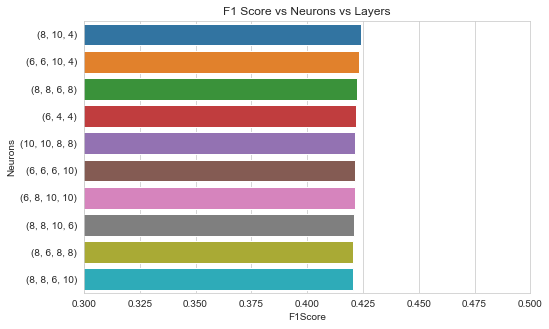

In [168]:
flatui = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c"]
plt.figure(figsize=(8, 5))
g =sns.barplot(data=pca_acc_df_head ,x='F1Score', y='Neurons',orient ="h")
g.set(xlim=(0.3, 0.5))
sns.set_style("whitegrid")
plt.title("F1 Score vs Neurons vs Layers")

In [287]:
#Best feature
from keras import backend as K
optimizer_value = keras.optimizers.Adam(learning_rate=0.01)
def recall_m(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
        recall = true_positives / (possible_positives + K.epsilon())
        return recall

def precision_m(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
        precision = true_positives / (predicted_positives + K.epsilon())
        return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))


model = Sequential()
model.add(Dense(8, input_dim=10, activation='sigmoid'))
model.add(Dense(10, activation='sigmoid'))
model.add(Dense(4, activation='sigmoid'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam', metrics=['acc',f1_m,precision_m, recall_m])

# Train_model

# Fit the model
model.fit(pca_x_train, pca_y_train, epochs=100,batch_size = 200,verbose=0)
pred_train = model.predict_classes(pca_x_train)
# print(scores_final_train)
print("Train Classification Report")
print(classification_report(pca_y_train,pred_train))
print('')
print("F-1 Score")
print(f1_score(pca_y_train,pred_train))
print('')
print("      Confusion Matrix")
print(pd.DataFrame(confusion_matrix(pca_y_train,pred_train),index=['Actual 0','Actual 1'],columns=['Predicted 0','Predicted 1']))

#------------------------------------------------------------------------------------------------#


model = Sequential()
model.add(Dense(8, input_dim=10, activation='sigmoid'))
model.add(Dense(10, activation='sigmoid'))
model.add(Dense(4, activation='sigmoid'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam')

# Fit the Model
model.fit(pca_x_train, pca_y_train, epochs=100,batch_size = 200,verbose=0)

# print("Test Measures")
# print(scores_final_test)
pred_test = model.predict_classes(pca_x_test)
print("Test Classification Report")
print(classification_report(pca_y_test,pred_test))
print('')
print("F-1 Score")
print(f1_score(pca_y_test,pred_test))
print('')
print("      Confusion Matrix")
print(pd.DataFrame(confusion_matrix(pca_y_test,pred_test),index=['Actual 0','Actual 1'],columns=['Predicted 0','Predicted 1']))


Train Classification Report
              precision    recall  f1-score   support

           0       0.65      0.98      0.78      7000
           1       0.90      0.30      0.45      5194

    accuracy                           0.69     12194
   macro avg       0.78      0.64      0.62     12194
weighted avg       0.76      0.69      0.64     12194


F-1 Score
0.45159428653873895

      Confusion Matrix
          Predicted 0  Predicted 1
Actual 0         6828          172
Actual 1         3629         1565
Test Classification Report
              precision    recall  f1-score   support

           0       0.84      0.99      0.91      8670
           1       0.88      0.27      0.42      2257

    accuracy                           0.84     10927
   macro avg       0.86      0.63      0.66     10927
weighted avg       0.85      0.84      0.81     10927


F-1 Score
0.4166666666666667

      Confusion Matrix
          Predicted 0  Predicted 1
Actual 0         8590           80
Actual 

dict_keys(['val_loss', 'val_acc', 'val_f1_m', 'val_precision_m', 'val_recall_m', 'loss', 'acc', 'f1_m', 'precision_m', 'recall_m'])


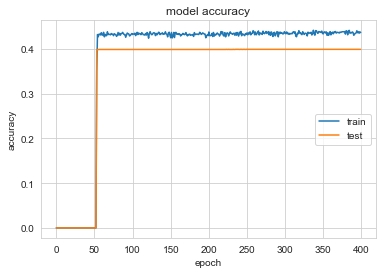

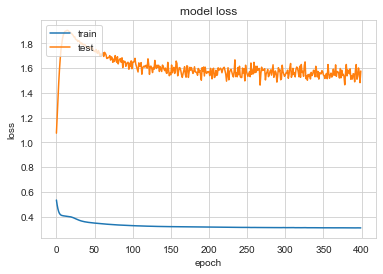

In [290]:
#Learing Curve with Epochs
model = Sequential()
model.add(Dense(8, input_dim=10, activation='sigmoid'))
model.add(Dense(10, activation='sigmoid'))
model.add(Dense(4, activation='sigmoid'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam', metrics=['acc',f1_m,precision_m, recall_m])
# Fit the model
history = model.fit(pca_x_train, pca_y_train,validation_split=0.33, epochs=400,batch_size = 200,verbose=0)
# list all data in history
print(history.history.keys())
# summarize history for accuracy
plt.plot(history.history['f1_m'])
plt.plot(history.history['val_f1_m'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='center right')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [176]:
#ANN ICA

In [291]:
ica_x_train_us, ica_x_test, ica_y_train_us, ica_y_test = train_test_split(ica_df_final,y,test_size=0.3,random_state=33)
ica_x_train, ica_y_train = undersampling(ica_x_train_us,ica_y_train_us)

In [179]:
#### Combination of Neurons and Layers
optimizer_value = keras.optimizers.Adam(learning_rate=0.01)
neurons_list = [2,3,5]
layers_combo = [1,2,3,4]
acc_list = []
ica_acc_df = pd.DataFrame()
for layer_no in layers_combo:
    print("The Number of layers:",layer_no)
    neurons_combo = [p for p in itertools.product(neurons_list, repeat=layer_no)]
    for neurons in neurons_combo:
        print("The tuple of Neurons:",neurons)
        model = Sequential()
        for layer in range(1,layer_no+1):
            if (layer == 1):
                model.add(Dense(neurons[0], input_dim=5, activation='sigmoid'))
            else:
                model.add(Dense(neurons[layer-1],activation='sigmoid'))
        model.add(Dense(1, activation='sigmoid'))
        model.compile(optimizer=optimizer_value, loss='binary_crossentropy')
        model.fit(ica_x_train, ica_y_train, epochs=25,batch_size=200)
        pred = model.predict_classes(ica_x_test)
        acc = f1_score(ica_y_test,pred)
        acc_values  =  [acc,layer_no,neurons]
        acc_values = pd.DataFrame(acc_values).T
        ica_acc_df = pd.concat([ica_acc_df,acc_values])

ica_acc_df.columns = ['F1Score','LayerNumber','Neurons']
ica_acc_df = ica_acc_df.sort_values(by='F1Score', ascending = False)
ica_acc_df_head = ica_acc_df.head(10)
ica_acc_df_head

The Number of layers: 1
The tuple of Neurons: (2,)
Epoch 1/25
12194/12194 [==============================] - 0s 14us/step - loss: 0.6828
Epoch 2/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6822
Epoch 3/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6823
Epoch 4/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6822
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6821
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6821
Epoch 7/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6822
Epoch 8/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6822
Epoch 9/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6819
Epoch 10/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6822
Epoch 11/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6819
Epoch 12/25

12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 20/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6822
Epoch 21/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6821
Epoch 22/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6824
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6821
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
The tuple of Neurons: (2, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 15us/step - loss: 0.6962
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 5/25
12194/12194 [================

12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 14/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6824
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 16/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6822
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 20/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6823
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 24/25
12194/12194 [==============================] - 0s 6us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.6821
Epoch 8/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6822
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6820
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6819
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6818
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6816
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6814
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6815
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6813
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6816
Epoch 17/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6812
Epoch 18/25
12194/12194 [==============================] - 0s 7us/st

Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6855
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6828
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 5/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6823
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 9/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6824
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 12/25
12194/12194 [==============================] - 0s 

12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6826
Epoch 22/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6824
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6819
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6821
The tuple of Neurons: (2, 5, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 21us/step - loss: 0.6951
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 3/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6822
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 5/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6823
Epoch 6/25
12194/12194 [==============

12194/12194 [==============================] - 0s 8us/step - loss: 0.6825
Epoch 15/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6825
Epoch 16/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6823
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 21/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6824
Epoch 22/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6824
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6827
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 25/25
12194/12194 [==============================] - 0s 7us/

Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6829
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6826
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6821
Epoch 19/25
12194/12194 [==============================]

12194/12194 [==============================] - 0s 7us/step - loss: 0.6832
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6826
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6826
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6826
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6827
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6827
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6826
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6827
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6827
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - 

12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
The tuple of Neurons: (5, 3, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 17us/step - loss: 0.6847
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6827
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 4/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6826
Epoch 5/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6823
Epoch 6/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6824
Epoch 7/25
12194/12194 [===============

12194/12194 [==============================] - 0s 8us/step - loss: 0.6825
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 17/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6822
Epoch 18/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6822
Epoch 19/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6823
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6821
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6821
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 25/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6822
The tuple of Neurons: (5, 5, 5)
Epoch 1/25
12194/12194 [==========

12194/12194 [==============================] - 0s 9us/step - loss: 0.6824
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6826
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6825
Epoch 13/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6824
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823A: 0s - loss: 0.681
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 16/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6823
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 19/25
12194/12194 [=======================

12194/12194 [==============================] - 0s 19us/step - loss: 0.6860
Epoch 2/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6831
Epoch 3/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6824
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 8/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6825
Epoch 9/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6823
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - 

12194/12194 [==============================] - 0s 9us/step - loss: 0.6822
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 23/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6823
Epoch 24/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6823
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
The tuple of Neurons: (2, 3, 2, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 20us/step - loss: 0.6859
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6827
Epoch 4/25
12194/12194 [==============================] - 0s 10us/step - loss: 0.6827
Epoch 5/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6828
Epoch 6/25
12194/12194 [==========

12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6821
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6821
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 24/25
12194/12194 [==============================] - 0s 8us/

12194/12194 [==============================] - 0s 9us/step - loss: 0.6827
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6827
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6828
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6833
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6831
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 17/25
12194/12194 [==============================] - 0s 8us/ste

12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
The tuple of Neurons: (2, 5, 3, 2)
Epoch 1/25
12194/12194 [==============================] - 0s 17us/step - loss: 0.6909
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 11/25
12194/12194 [==============

12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 25/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6823
The tuple of Neurons: (2, 5, 5, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 21us/step - loss: 0.6892
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6826
Epoch 4/25
12194/12194 [=========

12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6827
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6831
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6827
Epoch 22/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 7/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6831
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6826
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 10/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6824
Epoch 11/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6825
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 14/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6824
Epoch 15/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6830
Epoch 16/25
12194/12194 [==============================] - 0s 6us/step

12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6826
The tuple of Neurons: (3, 3, 2, 2)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6937
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 10/25
12194/12194 [==============

12194/12194 [==============================] - 0s 9us/step - loss: 0.6822
Epoch 19/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6822
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 22/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6823
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 25/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6822
The tuple of Neurons: (3, 3, 3, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6832
Epoch 2/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6834
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6829
Epoch 4/25
12194/12194 [=========

12194/12194 [==============================] - 0s 10us/step - loss: 0.6823
Epoch 13/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6822
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6826
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6825
Epoch 17/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6823
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 20/25
12194/12194 [==============================] - 0s 10us/step - loss: 0.6823
Epoch 21/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6824
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 23/25
12194/12194 [==============================] - 0s 8u

12194/12194 [==============================] - 0s 8us/step - loss: 0.6828
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6826
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6826
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6827
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 13/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6824
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6827
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 17/25
12194/12194 [==============================] - 0s 8us/ste

12194/12194 [==============================] - 0s 8us/step - loss: 0.6825
The tuple of Neurons: (3, 5, 5, 2)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6960
Epoch 2/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6823
Epoch 3/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6824
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6825
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 11/25
12194/12194 [==============

12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6821
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
The tuple of Neurons: (5, 2, 2, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 20us/step - loss: 0.7053
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 4/25
12194/12194 [=========

12194/12194 [==============================] - 0s 8us/step - loss: 0.6827
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6826
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6828
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 22/25
12194/12194 [==============================] - 0s 8us/

12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6827
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step

12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
The tuple of Neurons: (5, 3, 3, 2)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6984
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6825
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6826
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6826
Epoch 7/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6822
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6820
Epoch 10/25
12194/12194 [==============

12194/12194 [==============================] - 0s 6us/step - loss: 0.6823
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 21/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6823
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
The tuple of Neurons: (5, 3, 5, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6991
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 3/25
12194/12194 [========

12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6825
Epoch 16/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6823
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 18/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6822
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 22/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.6821
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6825
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6824
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6824
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6823
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6826
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822
Epoch 15/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6827
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step

12194/12194 [==============================] - 0s 10us/step - loss: 0.6829
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6822


,F1Score,LayerNumber,Neurons
0,0.00702988,2,"(5, 5)"
0,0.00529334,1,"(3,)"
0,0.00441306,1,"(5,)"
0,0.00177069,2,"(5, 3)"
0,0.00177069,2,"(3, 2)"
0,0.00176991,2,"(3, 5)"
0,0,4,"(3, 5, 2, 2)"
0,0,4,"(3, 3, 3, 3)"
0,0,4,"(3, 3, 3, 5)"
0,0,4,"(3, 3, 5, 2)"


In [183]:
ica_df_final

,Annual Income,Months since last delinquent,Number of Open Accounts,Current Credit Balance,Bankruptcies
0,0.022956,-0.000248,0.000965,0.000114,0.003287
1,-0.000776,-0.000288,0.000842,0.000207,0.000298
2,-0.000676,0.003592,0.000688,0.000366,0.006771
3,-0.000874,-0.000980,0.000598,0.000348,-0.002870
4,-0.000733,-0.000161,0.000538,0.000125,-0.002692
...,...,...,...,...,...
36418,-0.000779,-0.003038,0.000592,0.000092,-0.000169
36419,-0.000656,0.014303,0.000539,0.001937,-0.001541
36420,-0.000759,-0.002467,0.000573,-0.000097,-0.000969
36421,-0.000844,-0.001932,0.000603,0.000210,0.001074


Text(0.5, 1.0, 'F1 Score vs Neurons vs Layers')

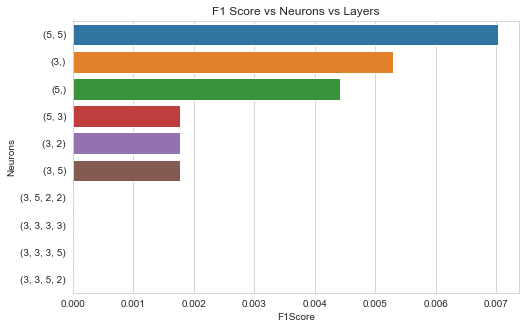

In [193]:
flatui = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c"]
plt.figure(figsize=(8, 5))
g =sns.barplot(data=ica_acc_df_head ,x='F1Score', y='Neurons',orient ="h")
# g.set(xlim=(0.3, 0.5))
sns.set_style("whitegrid")
plt.title("F1 Score vs Neurons vs Layers")

In [194]:
#Best feature
from keras import backend as K
optimizer_value = keras.optimizers.Adam(learning_rate=0.01)
def recall_m(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
        recall = true_positives / (possible_positives + K.epsilon())
        return recall

def precision_m(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
        precision = true_positives / (predicted_positives + K.epsilon())
        return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))


model = Sequential()
model.add(Dense(5, input_dim=5, activation='sigmoid'))
model.add(Dense(5, activation='sigmoid'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam', metrics=['acc',f1_m,precision_m, recall_m])

# Train_model

# Fit the model
model.fit(ica_x_train, ica_y_train, epochs=100,batch_size = 200,verbose=0)
pred_train = model.predict_classes(ica_x_train)
# print(scores_final_train)
print("Train Classification Report")
print(classification_report(ica_y_train,pred_train))
print('')
print("F-1 Score")
print(f1_score(ica_y_train,pred_train))
print('')
print("      Confusion Matrix")
print(pd.DataFrame(confusion_matrix(ica_y_train,pred_train),index=['Actual 0','Actual 1'],columns=['Predicted 0','Predicted 1']))

#------------------------------------------------------------------------------------------------#


model = Sequential()
model.add(Dense(5, input_dim=5, activation='sigmoid'))
model.add(Dense(5, activation='sigmoid'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam')

# Fit the Model
model.fit(ica_x_train, ica_y_train, epochs=100,batch_size = 200,verbose=0)

# print("Test Measures")
# print(scores_final_test)
pred_test = model.predict_classes(ica_x_test)
print("Test Classification Report")
print(classification_report(ica_y_test,pred_test))
print('')
print("F-1 Score")
print(f1_score(ica_y_test,pred_test))
print('')
print("      Confusion Matrix")
print(pd.DataFrame(confusion_matrix(ica_y_test,pred_test),index=['Actual 0','Actual 1'],columns=['Predicted 0','Predicted 1']))


Train Classification Report
              precision    recall  f1-score   support

           0       0.57      1.00      0.73      7000
           1       0.00      0.00      0.00      5194

    accuracy                           0.57     12194
   macro avg       0.29      0.50      0.36     12194
weighted avg       0.33      0.57      0.42     12194


F-1 Score
0.0

      Confusion Matrix
          Predicted 0  Predicted 1
Actual 0         7000            0
Actual 1         5194            0


C:\Users\saipr\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


Test Classification Report
              precision    recall  f1-score   support

           0       0.79      1.00      0.88      8670
           1       0.00      0.00      0.00      2257

    accuracy                           0.79     10927
   macro avg       0.40      0.50      0.44     10927
weighted avg       0.63      0.79      0.70     10927


F-1 Score
0.0

      Confusion Matrix
          Predicted 0  Predicted 1
Actual 0         8670            0
Actual 1         2257            0


dict_keys(['val_loss', 'val_acc', 'val_f1_m', 'val_precision_m', 'val_recall_m', 'loss', 'acc', 'f1_m', 'precision_m', 'recall_m'])


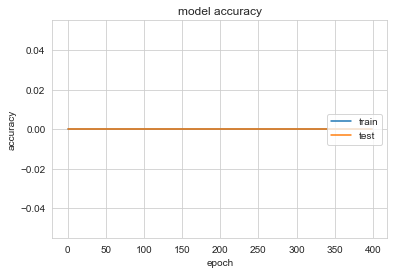

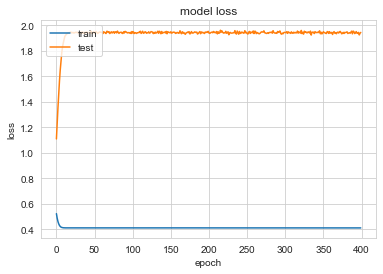

In [292]:
#Learing Curve with Epochs
model = Sequential()
model.add(Dense(5, input_dim=5, activation='sigmoid'))
model.add(Dense(5, activation='sigmoid'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam', metrics=['acc',f1_m,precision_m, recall_m])
# Fit the model
history = model.fit(ica_x_train, ica_y_train,validation_split=0.33, epochs=400,batch_size = 200,verbose=0)
# list all data in history
print(history.history.keys())
# summarize history for accuracy
plt.plot(history.history['f1_m'])
plt.plot(history.history['val_f1_m'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='center right')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [ ]:
#ANN RO

In [216]:
ro_x_train_us, ro_x_test, ro_y_train_us, ro_y_test = train_test_split(ro_df,y,test_size=0.3,random_state=33)
ro_x_train, ro_y_train = undersampling(ro_x_train_us,ro_y_train_us)

In [200]:
#### Combination of Neurons and Layers
optimizer_value = keras.optimizers.Adam(learning_rate=0.01)
neurons_list = [2,3,4]
layers_combo = [1,2,3,4]
acc_list = []
ro_acc_df = pd.DataFrame()
for layer_no in layers_combo:
    print("The Number of layers:",layer_no)
    neurons_combo = [p for p in itertools.product(neurons_list, repeat=layer_no)]
    for neurons in neurons_combo:
        print("The tuple of Neurons:",neurons)
        model = Sequential()
        for layer in range(1,layer_no+1):
            if (layer == 1):
                model.add(Dense(neurons[0], input_dim=4, activation='sigmoid'))
            else:
                model.add(Dense(neurons[layer-1],activation='sigmoid'))
        model.add(Dense(1, activation='sigmoid'))
        model.compile(optimizer=optimizer_value, loss='binary_crossentropy')
        model.fit(ro_x_train, ro_y_train, epochs=25,batch_size=200)
        pred = model.predict_classes(ro_x_test)
        acc = f1_score(ro_y_test,pred)
        acc_values  =  [acc,layer_no,neurons]
        acc_values = pd.DataFrame(acc_values).T
        ro_acc_df = pd.concat([ro_acc_df,acc_values])

ro_acc_df.columns = ['F1Score','LayerNumber','Neurons']
ro_acc_df = ro_acc_df.sort_values(by='F1Score', ascending = False)
ro_acc_df_head = ro_acc_df.head(10)
ro_acc_df_head

The Number of layers: 1
The tuple of Neurons: (2,)
Epoch 1/25
12194/12194 [==============================] - 0s 12us/step - loss: 0.6744
Epoch 2/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6330
Epoch 3/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6256
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6205
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6154
Epoch 6/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.6099
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6041
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5981
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5929
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5880
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5838
Epoch 12/25

12194/12194 [==============================] - 0s 7us/step - loss: 0.5612
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5598
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5600
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5597
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5588
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5584
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5591
The tuple of Neurons: (2, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 17us/step - loss: 0.6397
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6005
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5939
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5911
Epoch 5/25
12194/12194 [================

12194/12194 [==============================] - 0s 7us/step - loss: 0.5552
Epoch 14/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5549
Epoch 15/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5543
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5534
Epoch 17/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5538
Epoch 18/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5535
Epoch 19/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5531
Epoch 20/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5530
Epoch 21/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5523
Epoch 22/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5529
Epoch 23/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5523
Epoch 24/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5649
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5627
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5612
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5604
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5595
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5587
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5582
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5575
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5576
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5566
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5568
Epoch 18/25
12194/12194 [==============================] - 0s 7us/st

Epoch 1/25
12194/12194 [==============================] - 0s 17us/step - loss: 0.6804
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6179
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5891
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5876
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5878
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5870
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5867
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5869
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5868
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5864
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5866
Epoch 12/25
12194/12194 [==============================] - 0s 

12194/12194 [==============================] - 0s 7us/step - loss: 0.5601
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5601
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5591
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5592
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5589
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5584
The tuple of Neurons: (2, 4, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 16us/step - loss: 0.6576
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5914
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5886
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5882
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5873
Epoch 6/25
12194/12194 [==============

12194/12194 [==============================] - 0s 8us/step - loss: 0.5861
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5859
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5866
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5859
Epoch 18/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5857
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5859
Epoch 20/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5861
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5854
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5853
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5854
Epoch 24/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5855
Epoch 25/25
12194/12194 [==============================] - 0s 7us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5866
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5867
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5842
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5812
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5776
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5720
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5678
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5650
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5637
Epoch 17/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5617
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5606
Epoch 19/25
12194/12194 [==============================] - 0s 8us/s

12194/12194 [==============================] - 0s 16us/step - loss: 0.6814
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6465
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6145
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5989
Epoch 5/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5865
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5752
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5705
Epoch 8/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5671
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5640
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5633
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5614
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - 

12194/12194 [==============================] - 0s 7us/step - loss: 0.5862
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5860
Epoch 22/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5861
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5857
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5860
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5860
The tuple of Neurons: (4, 3, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 16us/step - loss: 0.6359
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5907
Epoch 3/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5853
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5768
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5688
Epoch 6/25
12194/12194 [==============

12194/12194 [==============================] - 0s 8us/step - loss: 0.5569
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5548
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5557
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5540
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5539
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5533
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5527
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5533
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5530
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5527
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5535
Epoch 25/25
12194/12194 [==============================] - 0s 8us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5879
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5882
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5883
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5877
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5876
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5873
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5870
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5875
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5874
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5875
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5871
Epoch 18/25
12194/12194 [==============================] - 0s 7us/st

12194/12194 [==============================] - 0s 19us/step - loss: 0.6818
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6226
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5919
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5844
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5791
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5718
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5663
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5683
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5640
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5625
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5624
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - 

12194/12194 [==============================] - 0s 8us/step - loss: 0.5878
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5878
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5879
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5878
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5875
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5877
The tuple of Neurons: (2, 3, 2, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6835
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6445
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6132
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6005
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5935
Epoch 6/25
12194/12194 [===========

12194/12194 [==============================] - 0s 8us/step - loss: 0.5869
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5869
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5867
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5870
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5864
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5862
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5866
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5866
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5865
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5867
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5863
Epoch 24/25
12194/12194 [==============================] - 0s 8us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5881
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5883
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5875
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5871
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5866
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5854
Epoch 12/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5851
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5811
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5765
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5723
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5685A: 0s - loss: 0.564
Epoch 17/25
12194/12194 [=========================

Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5873
The tuple of Neurons: (2, 4, 3, 2)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6869
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6828
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6821
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6823
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6820
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6617
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5959
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5896
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5884
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5883
Epoch 11/25
12194/12194 [==

12194/12194 [==============================] - 0s 8us/step - loss: 0.5862
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5863
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5864
Epoch 21/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5861
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5862
Epoch 23/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5859
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5851
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5843
The tuple of Neurons: (2, 4, 4, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6928
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6813
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6667
Epoch 4/25
12194/12194 [=========

12194/12194 [==============================] - 0s 7us/step - loss: 0.5878
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5872
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5869
Epoch 15/25
12194/12194 [==============================] - 0s 10us/step - loss: 0.5867
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5865
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5863
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5866
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5859
Epoch 20/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5859
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5858
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5862
Epoch 23/25
12194/12194 [==============================] - 0s 7us

12194/12194 [==============================] - 0s 7us/step - loss: 0.5886
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5869
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5833
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5766
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5724
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5680
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5648
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5642
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5640
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5633
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5609
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step

12194/12194 [==============================] - 0s 7us/step - loss: 0.5862
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5861
The tuple of Neurons: (3, 3, 2, 2)
Epoch 1/25
12194/12194 [==============================] - 0s 17us/step - loss: 0.6829
Epoch 2/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6582
Epoch 3/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.6116
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5869
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5749
Epoch 6/25
12194/12194 [==============================] - 0s 10us/step - loss: 0.5680
Epoch 7/25
12194/12194 [==============================] - 0s 10us/step - loss: 0.5655
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5625
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5610
Epoch 10/25
12194/12194 [============

12194/12194 [==============================] - 0s 8us/step - loss: 0.5860
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5857
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5859
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5858
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5857
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5854
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5855
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5855
The tuple of Neurons: (3, 3, 3, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 20us/step - loss: 0.6859
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6291
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5922
Epoch 4/25
12194/12194 [=========

12194/12194 [==============================] - 0s 8us/step - loss: 0.5871
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5861
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5852
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5838
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5818
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5768
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5723
Epoch 18/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5714
Epoch 19/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5668
Epoch 20/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5653
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5650
Epoch 22/25
12194/12194 [==============================] - 0s 9us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5922
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5903
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5887
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5878
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5880
Epoch 9/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5877
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5873
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5874
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5872
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5872
Epoch 14/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5870
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step 

12194/12194 [==============================] - 0s 8us/step - loss: 0.5859
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5860
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5858
The tuple of Neurons: (3, 4, 4, 2)
Epoch 1/25
12194/12194 [==============================] - 0s 20us/step - loss: 0.6893
Epoch 2/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6818
Epoch 3/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6676
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.6052
Epoch 5/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5923
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5900
Epoch 7/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5884
Epoch 8/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5879
Epoch 9/25
12194/12194 [==============

12194/12194 [==============================] - 0s 8us/step - loss: 0.5866
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5854
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5854
Epoch 19/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5858
Epoch 20/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5857
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5855
Epoch 22/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5856
Epoch 23/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5856
Epoch 24/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5856
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5853
The tuple of Neurons: (4, 2, 2, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 18us/step - loss: 0.6476
Epoch 2/25
12194/12194 [=======

12194/12194 [==============================] - 0s 8us/step - loss: 0.5869
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5869
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5867
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5863
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5866
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5860
Epoch 15/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5818
Epoch 16/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5723
Epoch 17/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5670
Epoch 18/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5666
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5639
Epoch 20/25
12194/12194 [==============================] - 0s 8us/

12194/12194 [==============================] - 0s 8us/step - loss: 0.5924
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5892
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5891
Epoch 6/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5884
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5879
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5865
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5864
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5850
Epoch 11/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5792
Epoch 12/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5704
Epoch 13/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5675
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step -

12194/12194 [==============================] - 0s 7us/step - loss: 0.5852
Epoch 23/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5847
Epoch 24/25
12194/12194 [==============================] - 0s 5us/step - loss: 0.5852
Epoch 25/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5852
The tuple of Neurons: (4, 3, 3, 2)
Epoch 1/25
12194/12194 [==============================] - 0s 17us/step - loss: 0.6846
Epoch 2/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.6307
Epoch 3/25
12194/12194 [==============================] - 0s 11us/step - loss: 0.5943
Epoch 4/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5903
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5889
Epoch 6/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5890
Epoch 7/25
12194/12194 [==============================] - 0s 5us/step - loss: 0.5879
Epoch 8/25
12194/12194 [============

12194/12194 [==============================] - 0s 9us/step - loss: 0.5876
Epoch 17/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5871
Epoch 18/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5869
Epoch 19/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5869
Epoch 20/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5873
Epoch 21/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5873
Epoch 22/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5873
Epoch 23/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5869
Epoch 24/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5870
Epoch 25/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5869
The tuple of Neurons: (4, 3, 4, 3)
Epoch 1/25
12194/12194 [==============================] - 0s 19us/step - loss: 0.6843
Epoch 2/25
12194/12194 [=======

12194/12194 [==============================] - 0s 9us/step - loss: 0.5887
Epoch 10/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5886
Epoch 11/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5875
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5880
Epoch 13/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5872
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5868
Epoch 15/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5870
Epoch 16/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5863
Epoch 17/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5865
Epoch 18/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5861
Epoch 19/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5861
Epoch 20/25
12194/12194 [==============================] - 0s 8us/

12194/12194 [==============================] - 0s 7us/step - loss: 0.5895
Epoch 4/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5895
Epoch 5/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5884
Epoch 6/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5877
Epoch 7/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5876
Epoch 8/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5881
Epoch 9/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5877
Epoch 10/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5876
Epoch 11/25
12194/12194 [==============================] - 0s 6us/step - loss: 0.5872
Epoch 12/25
12194/12194 [==============================] - 0s 8us/step - loss: 0.5872
Epoch 13/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5872
Epoch 14/25
12194/12194 [==============================] - 0s 8us/step -

12194/12194 [==============================] - 0s 8us/step - loss: 0.5862
Epoch 23/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5861
Epoch 24/25
12194/12194 [==============================] - 0s 9us/step - loss: 0.5859
Epoch 25/25
12194/12194 [==============================] - 0s 7us/step - loss: 0.5857


,F1Score,LayerNumber,Neurons
0,0.41258,2,"(2, 3)"
0,0.411118,2,"(3, 3)"
0,0.409993,3,"(4, 2, 2)"
0,0.4092,4,"(3, 4, 4, 3)"
0,0.40895,4,"(3, 3, 2, 4)"
0,0.408825,4,"(3, 2, 4, 3)"
0,0.408779,3,"(4, 4, 3)"
0,0.408669,4,"(2, 2, 3, 4)"
0,0.408558,3,"(4, 2, 3)"
0,0.408402,3,"(4, 4, 4)"


Text(0.5, 1.0, 'F1 Score vs Neurons vs Layers')

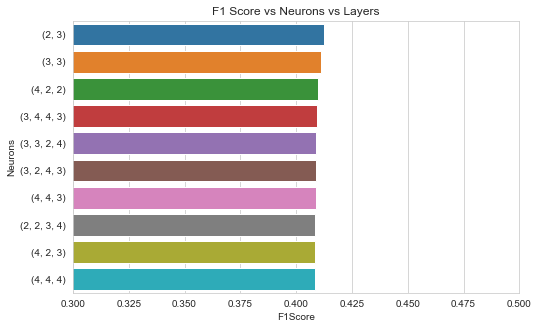

In [201]:
flatui = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c"]
plt.figure(figsize=(8, 5))
g =sns.barplot(data=ro_acc_df_head ,x='F1Score', y='Neurons',orient ="h")
g.set(xlim=(0.3, 0.5))
sns.set_style("whitegrid")
plt.title("F1 Score vs Neurons vs Layers")

In [293]:
#Best feature
from keras import backend as K
optimizer_value = keras.optimizers.Adam(learning_rate=0.01)
def recall_m(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
        recall = true_positives / (possible_positives + K.epsilon())
        return recall

def precision_m(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
        precision = true_positives / (predicted_positives + K.epsilon())
        return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))


model = Sequential()
model.add(Dense(2, input_dim=4, activation='sigmoid'))
model.add(Dense(3, activation='sigmoid'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam', metrics=['acc',f1_m,precision_m, recall_m])

# Train_model

# Fit the model
model.fit(ro_x_train, ro_y_train, epochs=100,batch_size = 200,verbose=0)
pred_train = model.predict_classes(ro_x_train)
# print(scores_final_train)
print("Train Classification Report")
print(classification_report(ro_y_train,pred_train))
print('')
print("F-1 Score")
print(f1_score(ro_y_train,pred_train))
print('')
print("      Confusion Matrix")
print(pd.DataFrame(confusion_matrix(ro_y_train,pred_train),index=['Actual 0','Actual 1'],columns=['Predicted 0','Predicted 1']))

#------------------------------------------------------------------------------------------------#


model = Sequential()
model.add(Dense(2, input_dim=4, activation='sigmoid'))
model.add(Dense(3, activation='sigmoid'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam')

# Fit the Model
model.fit(ro_x_train, ro_y_train, epochs=100,batch_size = 200,verbose=0)

# print("Test Measures")
# print(scores_final_test)
pred_test = model.predict_classes(ro_x_test)
print("Test Classification Report")
print(classification_report(ro_y_test,pred_test))
print('')
print("F-1 Score")
print(f1_score(ro_y_test,pred_test))
print('')
print("      Confusion Matrix")
print(pd.DataFrame(confusion_matrix(ro_y_test,pred_test),index=['Actual 0','Actual 1'],columns=['Predicted 0','Predicted 1']))


Train Classification Report
              precision    recall  f1-score   support

           0       0.64      0.97      0.77      7000
           1       0.87      0.28      0.42      5194

    accuracy                           0.68     12194
   macro avg       0.76      0.62      0.60     12194
weighted avg       0.74      0.68      0.62     12194


F-1 Score
0.42284715139151974

      Confusion Matrix
          Predicted 0  Predicted 1
Actual 0         6782          218
Actual 1         3743         1451
Test Classification Report
              precision    recall  f1-score   support

           0       0.84      0.94      0.89      8670
           1       0.59      0.32      0.41      2257

    accuracy                           0.81     10927
   macro avg       0.71      0.63      0.65     10927
weighted avg       0.79      0.81      0.79     10927


F-1 Score
0.4104929374459499

      Confusion Matrix
          Predicted 0  Predicted 1
Actual 0         8170          500
Actual 

dict_keys(['val_loss', 'val_acc', 'val_f1_m', 'val_precision_m', 'val_recall_m', 'loss', 'acc', 'f1_m', 'precision_m', 'recall_m'])


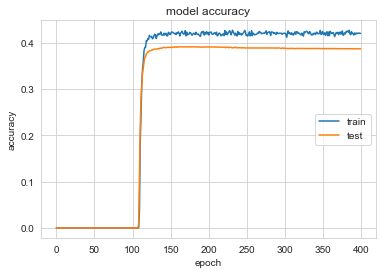

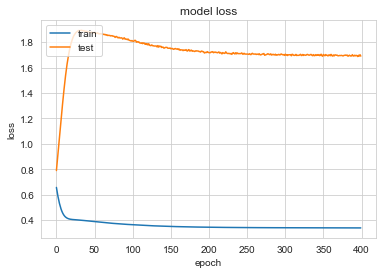

In [203]:
#Learing Curve with Epochs
model = Sequential()
model.add(Dense(2, input_dim=4, activation='sigmoid'))
model.add(Dense(3, activation='sigmoid'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam', metrics=['acc',f1_m,precision_m, recall_m])
# Fit the model
history = model.fit(ro_x_train, ro_y_train,validation_split=0.33, epochs=400,batch_size = 200,verbose=0)
# list all data in history
print(history.history.keys())
# summarize history for accuracy
plt.plot(history.history['f1_m'])
plt.plot(history.history['val_f1_m'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='center right')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [204]:
comb_df = pd.DataFrame()
comb_df[['km_cluster']] = km_df[['Cluster']]
comb_df[['em_cluster']] = gmm_df[['Cluster']]
comb_df = pd.concat([comb_df,y],axis=1)

In [207]:
comb_x = comb_df.drop(['Loan Status'],axis=1)
comb_y = comb_df.iloc[:,2:]

In [208]:
comb_x['km_cluster'] = ['Cluster 1' if x == 1 else 'Cluster 2' for x in comb_x['km_cluster']]
comb_x['em_cluster'] = ['Cluster 1' if x == 1 else 'Cluster 2' for x in comb_x['em_cluster']]

In [209]:
com_x_dum = pd.get_dummies(comb_x)

In [229]:
co_x_train_us, co_x_test, co_y_train_us, co_y_test = train_test_split(com_x_dum,comb_y,test_size=0.3,random_state=33)
# co_x_train, co_y_train = undersampling(co_x_train_us,co_y_train_us)

In [230]:
co_x_train_us

,km_cluster_Cluster 1,km_cluster_Cluster 2,em_cluster_Cluster 1,em_cluster_Cluster 2
16895,0,1,0,1
23872,1,0,1,0
2500,0,1,0,1
4186,0,1,0,1
6179,0,1,0,1
...,...,...,...,...
27849,0,1,0,1
27282,0,1,0,1
578,1,0,0,1
2439,0,1,1,0


In [231]:
#### Combination of Neurons and Layers
optimizer_value = keras.optimizers.Adam(learning_rate=0.01)
neurons_list = [2,3,4]
layers_combo = [1,2,3,4]
acc_list = []
co_acc_df = pd.DataFrame()
for layer_no in layers_combo:
    print("The Number of layers:",layer_no)
    neurons_combo = [p for p in itertools.product(neurons_list, repeat=layer_no)]
    for neurons in neurons_combo:
        print("The tuple of Neurons:",neurons)
        model = Sequential()
        for layer in range(1,layer_no+1):
            if (layer == 1):
                model.add(Dense(neurons[0], input_dim=4, activation='tanh'))
            else:
                model.add(Dense(neurons[layer-1],activation='sigmoid'))
        model.add(Dense(1, activation='sigmoid'))
        model.compile(optimizer=optimizer_value, loss='binary_crossentropy')
        model.fit(co_x_train_us, co_y_train_us, epochs=25,batch_size=200)
        pred = model.predict_classes(co_x_test)
        acc = f1_score(co_y_test,pred)
        acc_values  =  [acc,layer_no,neurons]
        acc_values = pd.DataFrame(acc_values).T
        co_acc_df = pd.concat([co_acc_df,acc_values])

co_acc_df.columns = ['F1Score','LayerNumber','Neurons']
co_acc_df = co_acc_df.sort_values(by='F1Score', ascending = False)
co_acc_df_head = co_acc_df.head(10)
co_acc_df_head

The Number of layers: 1
The tuple of Neurons: (2,)
Epoch 1/25
25496/25496 [==============================] - 1s 26us/step - loss: 0.4967
Epoch 2/25
25496/25496 [==============================] - 1s 26us/step - loss: 0.4794
Epoch 3/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4762
Epoch 4/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4752
Epoch 5/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4747
Epoch 6/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4742
Epoch 7/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4740
Epoch 8/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4737
Epoch 9/25
25496/25496 [==============================] - 0s 9us/step - loss: 0.4737
Epoch 10/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4736
Epoch 11/25
25496/25496 [==============================] - 0s 9us/step - loss: 0.4736
Epo

25496/25496 [==============================] - 0s 11us/step - loss: 0.4727
Epoch 20/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4725
Epoch 21/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4725
Epoch 22/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4726
Epoch 23/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4725
Epoch 24/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4726
Epoch 25/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4725
The tuple of Neurons: (2, 3)
Epoch 1/25
25496/25496 [==============================] - 1s 24us/step - loss: 0.5198
Epoch 2/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.5053
Epoch 3/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.5034
Epoch 4/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4835
Epoch 5/25
25496/25496 [======

25496/25496 [==============================] - 0s 10us/step - loss: 0.4726
Epoch 13/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4726
Epoch 14/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4727
Epoch 15/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4727
Epoch 16/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4726
Epoch 17/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4727
Epoch 18/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4727
Epoch 19/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4726
Epoch 20/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4727
Epoch 21/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4726
Epoch 22/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4726
Epoch 23/25
25496/25496 [==============================

25496/25496 [==============================] - 0s 11us/step - loss: 0.4732
Epoch 5/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4732
Epoch 6/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4728
Epoch 7/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4729
Epoch 8/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4729
Epoch 9/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4728
Epoch 10/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4728
Epoch 11/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4727
Epoch 12/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4727
Epoch 13/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4727
Epoch 14/25
25496/25496 [==============================] - 0s 10us/step - loss: 0.4726
Epoch 15/25
25496/25496 [==============================] - 0

25496/25496 [==============================] - 0s 11us/step - loss: 0.4729: 0s - loss: 0.4
Epoch 23/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4727
Epoch 24/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4727
Epoch 25/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4728
The tuple of Neurons: (2, 3, 2)
Epoch 1/25
25496/25496 [==============================] - 0s 16us/step - loss: 0.4841
Epoch 2/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4744
Epoch 3/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4733
Epoch 4/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4736
Epoch 5/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4735
Epoch 6/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4731
Epoch 7/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4731
Epoch 8/25
254

25496/25496 [==============================] - 0s 12us/step - loss: 0.4733
Epoch 15/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4732: 0s - loss: 0
Epoch 16/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4731
Epoch 17/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4732
Epoch 18/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4730
Epoch 19/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4730
Epoch 20/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4729
Epoch 21/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4730
Epoch 22/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4729
Epoch 23/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4729: 0s - loss: 0.
Epoch 24/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4729
Epoch 25/25
25496/25496 [=

25496/25496 [==============================] - 0s 12us/step - loss: 0.4754
Epoch 7/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4750
Epoch 8/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4744
Epoch 9/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4743
Epoch 10/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4741
Epoch 11/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4738
Epoch 12/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4736
Epoch 13/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4734
Epoch 14/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4735
Epoch 15/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4734
Epoch 16/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4733
Epoch 17/25
25496/25496 [==============================] -

Epoch 24/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4726
Epoch 25/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4726
The tuple of Neurons: (3, 3, 4)
Epoch 1/25
25496/25496 [==============================] - 0s 19us/step - loss: 0.4948
Epoch 2/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4762
Epoch 3/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4749
Epoch 4/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4743
Epoch 5/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4738
Epoch 6/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4737
Epoch 7/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4732
Epoch 8/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4737
Epoch 9/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4731
Epoch 10/25
25496/25

25496/25496 [==============================] - 0s 13us/step - loss: 0.4731
Epoch 18/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4730
Epoch 19/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4730
Epoch 20/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4730
Epoch 21/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4731
Epoch 22/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4732
Epoch 23/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4734
Epoch 24/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 25/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4728
The tuple of Neurons: (4, 2, 2)
Epoch 1/25
25496/25496 [==============================] - 0s 18us/step - loss: 0.5079
Epoch 2/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4798
Epoch 3/25
25496/25496 [=

25496/25496 [==============================] - 0s 13us/step - loss: 0.4730
Epoch 11/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4731
Epoch 12/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4731
Epoch 13/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4730
Epoch 14/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4728
Epoch 15/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4729
Epoch 16/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 17/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4728
Epoch 18/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 19/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4729
Epoch 20/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 21/25
25496/25496 [==============================

25496/25496 [==============================] - 0s 13us/step - loss: 0.4732
Epoch 4/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4735
Epoch 5/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4729
Epoch 6/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4730
Epoch 7/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 8/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4729
Epoch 9/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4726
Epoch 10/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4729
Epoch 11/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4726
Epoch 12/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 13/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4727
Epoch 14/25
25496/25496 [==============================] - 0s

25496/25496 [==============================] - 0s 13us/step - loss: 0.4733
Epoch 21/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4731
Epoch 22/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4732
Epoch 23/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4731
Epoch 24/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4731
Epoch 25/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4729
The tuple of Neurons: (2, 2, 2, 4)
Epoch 1/25
25496/25496 [==============================] - 1s 20us/step - loss: 0.4870
Epoch 2/25
25496/25496 [==============================] - 0s 17us/step - loss: 0.4741
Epoch 3/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4739
Epoch 4/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4734
Epoch 5/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4730
Epoch 6/25
25496/25496 [=

25496/25496 [==============================] - 0s 13us/step - loss: 0.4729
Epoch 13/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4730
Epoch 14/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4729
Epoch 15/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4729
Epoch 16/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 17/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 18/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 19/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4727
Epoch 20/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4727
Epoch 21/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4727
Epoch 22/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 23/25
25496/25496 [==============================

25496/25496 [==============================] - 0s 13us/step - loss: 0.4825
Epoch 6/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4769
Epoch 7/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4751
Epoch 8/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4743
Epoch 9/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4739
Epoch 10/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4736
Epoch 11/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4738
Epoch 12/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4733
Epoch 13/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4732
Epoch 14/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4732
Epoch 15/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4731
Epoch 16/25
25496/25496 [==============================] - 

25496/25496 [==============================] - 0s 12us/step - loss: 0.4732
Epoch 24/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4729
Epoch 25/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4731
The tuple of Neurons: (2, 3, 3, 3)
Epoch 1/25
25496/25496 [==============================] - 0s 19us/step - loss: 0.5131
Epoch 2/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4917
Epoch 3/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4813
Epoch 4/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4778
Epoch 5/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4761
Epoch 6/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4754
Epoch 7/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4750
Epoch 8/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4744
Epoch 9/25
25496/25496 [====

25496/25496 [==============================] - 0s 13us/step - loss: 0.4746
Epoch 17/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4743
Epoch 18/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4741
Epoch 19/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4738
Epoch 20/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4737
Epoch 21/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4736
Epoch 22/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4734
Epoch 23/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4732
Epoch 24/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4734
Epoch 25/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4733
The tuple of Neurons: (2, 3, 4, 4)
Epoch 1/25
25496/25496 [==============================] - 1s 23us/step - loss: 0.5486
Epoch 2/25
25496/2549

25496/25496 [==============================] - 0s 11us/step - loss: 0.4736
Epoch 10/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4734
Epoch 11/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4740
Epoch 12/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4735
Epoch 13/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4734
Epoch 14/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4733
Epoch 15/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4734
Epoch 16/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4733
Epoch 17/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4730
Epoch 18/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4735
Epoch 19/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4732
Epoch 20/25
25496/25496 [==============================

25496/25496 [==============================] - 0s 13us/step - loss: 0.4742
Epoch 3/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4736
Epoch 4/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4733
Epoch 5/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4734
Epoch 6/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4731
Epoch 7/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4732
Epoch 8/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4728
Epoch 9/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4728
Epoch 10/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4729
Epoch 11/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4729
Epoch 12/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4727
Epoch 13/25
25496/25496 [==============================] - 0s 

25496/25496 [==============================] - 0s 13us/step - loss: 0.5057
Epoch 21/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.5058
Epoch 22/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.5057
Epoch 23/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.5057
Epoch 24/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.5057
Epoch 25/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.5056
The tuple of Neurons: (3, 2, 2, 3)
Epoch 1/25
25496/25496 [==============================] - 0s 19us/step - loss: 0.5099
Epoch 2/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4904
Epoch 3/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4794
Epoch 4/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4762
Epoch 5/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4752
Epoch 6/25
25496/25496 [=

25496/25496 [==============================] - 0s 14us/step - loss: 0.4728
Epoch 14/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 15/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 16/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4728
Epoch 17/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4729
Epoch 18/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 19/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4729
Epoch 20/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4727
Epoch 21/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 22/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4727
Epoch 23/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4728
Epoch 24/25
25496/25496 [==============================

25496/25496 [==============================] - 0s 15us/step - loss: 0.4741
Epoch 6/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4738
Epoch 7/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4735
Epoch 8/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4732
Epoch 9/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4731
Epoch 10/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4731
Epoch 11/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4734
Epoch 12/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 13/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4730
Epoch 14/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4732
Epoch 15/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4730
Epoch 16/25
25496/25496 [==============================] - 

25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 24/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4729
Epoch 25/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
The tuple of Neurons: (3, 3, 3, 2)
Epoch 1/25
25496/25496 [==============================] - 1s 20us/step - loss: 0.5139
Epoch 2/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.5019
Epoch 3/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4828
Epoch 4/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4765
Epoch 5/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4748
Epoch 6/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4742
Epoch 7/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4737
Epoch 8/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4734
Epoch 9/25
25496/25496 [====

25496/25496 [==============================] - 0s 14us/step - loss: 0.5056
Epoch 16/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.5056
Epoch 17/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.5056
Epoch 18/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.5056
Epoch 19/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.5057
Epoch 20/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.5054
Epoch 21/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4968
Epoch 22/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4776
Epoch 23/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4749
Epoch 24/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4741
Epoch 25/25
25496/25496 [==============================] - 0s 15us/step - loss: 0.4736
The tuple of Neurons: (3, 3, 4, 3)
Epoch 1/25
25496/254

25496/25496 [==============================] - 0s 13us/step - loss: 0.4731
Epoch 9/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4732
Epoch 10/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4729
Epoch 11/25
25496/25496 [==============================] - 0s 17us/step - loss: 0.4729
Epoch 12/25
25496/25496 [==============================] - 0s 15us/step - loss: 0.4729
Epoch 13/25
25496/25496 [==============================] - 0s 15us/step - loss: 0.4728
Epoch 14/25
25496/25496 [==============================] - 0s 15us/step - loss: 0.4728
Epoch 15/25
25496/25496 [==============================] - 0s 15us/step - loss: 0.4730
Epoch 16/25
25496/25496 [==============================] - 0s 16us/step - loss: 0.4728
Epoch 17/25
25496/25496 [==============================] - 0s 15us/step - loss: 0.4728
Epoch 18/25
25496/25496 [==============================] - 0s 15us/step - loss: 0.4728
Epoch 19/25
25496/25496 [==============================]

25496/25496 [==============================] - 0s 19us/step - loss: 0.5037
Epoch 2/25
25496/25496 [==============================] - 0s 16us/step - loss: 0.4789
Epoch 3/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4750
Epoch 4/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4741
Epoch 5/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4741
Epoch 6/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4733
Epoch 7/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4732
Epoch 8/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4732
Epoch 9/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4731
Epoch 10/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4732
Epoch 11/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4731
Epoch 12/25
25496/25496 [==============================] - 0s 1

25496/25496 [==============================] - 0s 13us/step - loss: 0.4729
Epoch 20/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4727
Epoch 21/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4729
Epoch 22/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4728
Epoch 23/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4729
Epoch 24/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4727
Epoch 25/25
25496/25496 [==============================] - 0s 15us/step - loss: 0.4726
The tuple of Neurons: (4, 2, 2, 2)
Epoch 1/25
25496/25496 [==============================] - 0s 17us/step - loss: 0.5090
Epoch 2/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4893
Epoch 3/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4782
Epoch 4/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.4755
Epoch 5/25
25496/25496 [

25496/25496 [==============================] - 0s 13us/step - loss: 0.4994
Epoch 13/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4842
Epoch 14/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4788
Epoch 15/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4767
Epoch 16/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4758
Epoch 17/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4750
Epoch 18/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4747
Epoch 19/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4744
Epoch 20/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4740
Epoch 21/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4740
Epoch 22/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4739
Epoch 23/25
25496/25496 [==============================

25496/25496 [==============================] - 0s 13us/step - loss: 0.4917
Epoch 6/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4824
Epoch 7/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4787
Epoch 8/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4766
Epoch 9/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4757
Epoch 10/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4750
Epoch 11/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4745
Epoch 12/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4743
Epoch 13/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4740
Epoch 14/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4737
Epoch 15/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4736
Epoch 16/25
25496/25496 [==============================] - 

25496/25496 [==============================] - 0s 12us/step - loss: 0.4728
Epoch 24/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4728
Epoch 25/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
The tuple of Neurons: (4, 3, 2, 4)
Epoch 1/25
25496/25496 [==============================] - 1s 20us/step - loss: 0.5141
Epoch 2/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.5057
Epoch 3/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.5056
Epoch 4/25
25496/25496 [==============================] - 0s 15us/step - loss: 0.5057
Epoch 5/25
25496/25496 [==============================] - 0s 15us/step - loss: 0.5058
Epoch 6/25
25496/25496 [==============================] - 0s 16us/step - loss: 0.5058
Epoch 7/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.5057
Epoch 8/25
25496/25496 [==============================] - 0s 11us/step - loss: 0.5058
Epoch 9/25
25496/25496 [====

25496/25496 [==============================] - 0s 11us/step - loss: 0.4730
Epoch 17/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4730
Epoch 18/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4729
Epoch 19/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4728
Epoch 20/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4728
Epoch 21/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4731
Epoch 22/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4729
Epoch 23/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4729
Epoch 24/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4729
Epoch 25/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4731
The tuple of Neurons: (4, 3, 4, 2)
Epoch 1/25
25496/25496 [==============================] - 0s 19us/step - loss: 0.5184
Epoch 2/25
25496/2549

25496/25496 [==============================] - 0s 12us/step - loss: 0.4873
Epoch 9/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4807
Epoch 10/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4778
Epoch 11/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4763
Epoch 12/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4754
Epoch 13/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4750
Epoch 14/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4746
Epoch 15/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4741
Epoch 16/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4739
Epoch 17/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4737
Epoch 18/25
25496/25496 [==============================] - 0s 12us/step - loss: 0.4735
Epoch 19/25
25496/25496 [==============================]

25496/25496 [==============================] - 1s 21us/step - loss: 0.4856
Epoch 2/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4738
Epoch 3/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4732
Epoch 4/25
25496/25496 [==============================] - 0s 15us/step - loss: 0.4730
Epoch 5/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4729
Epoch 6/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 7/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4730
Epoch 8/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4728
Epoch 9/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4726
Epoch 10/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4727
Epoch 11/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4727
Epoch 12/25
25496/25496 [==============================] - 0s 1

25496/25496 [==============================] - 0s 15us/step - loss: 0.4728
Epoch 20/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4727
Epoch 21/25
25496/25496 [==============================] - 0s 13us/step - loss: 0.4726
Epoch 22/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4727
Epoch 23/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4728
Epoch 24/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4728
Epoch 25/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4726
The tuple of Neurons: (4, 4, 4, 4)
Epoch 1/25
25496/25496 [==============================] - 1s 20us/step - loss: 0.5189
Epoch 2/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.5054
Epoch 3/25
25496/25496 [==============================] - 0s 14us/step - loss: 0.4976
Epoch 4/25
25496/25496 [==============================] - 0s 15us/step - loss: 0.4839
Epoch 5/25
25496/25496 [

,F1Score,LayerNumber,Neurons
0,0,1,"(2,)"
0,0,1,"(3,)"
0,0,4,"(3, 4, 3, 3)"
0,0,4,"(3, 4, 3, 2)"
0,0,4,"(3, 4, 2, 4)"
0,0,4,"(3, 4, 2, 3)"
0,0,4,"(3, 4, 2, 2)"
0,0,4,"(3, 3, 4, 4)"
0,0,4,"(3, 3, 4, 3)"
0,0,4,"(3, 3, 4, 2)"


In [234]:
co_acc_df

,F1Score,LayerNumber,Neurons
0,0,1,"(2,)"
0,0,1,"(3,)"
0,0,4,"(3, 4, 3, 3)"
0,0,4,"(3, 4, 3, 2)"
0,0,4,"(3, 4, 2, 4)"
...,...,...,...
0,0,3,"(4, 3, 4)"
0,0,3,"(4, 3, 3)"
0,0,3,"(4, 3, 2)"
0,0,3,"(4, 2, 4)"


Text(0.5, 1.0, 'F1 Score vs Neurons vs Layers')

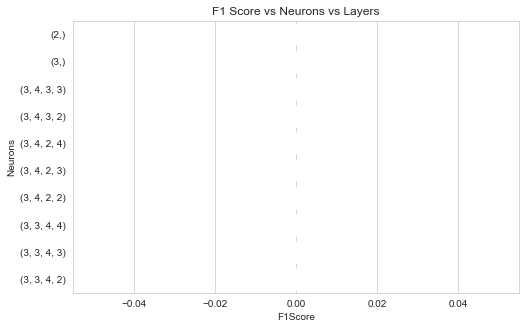

In [233]:
flatui = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c"]
plt.figure(figsize=(8, 5))
g =sns.barplot(data=co_acc_df_head ,x='F1Score', y='Neurons',orient ="h")
# g.set(xlim=(0.3, 0.5))
sns.set_style("whitegrid")
plt.title("F1 Score vs Neurons vs Layers")

In [294]:
#Best feature
from keras import backend as K
optimizer_value = keras.optimizers.Adam(learning_rate=0.01)
def recall_m(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
        recall = true_positives / (possible_positives + K.epsilon())
        return recall

def precision_m(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
        precision = true_positives / (predicted_positives + K.epsilon())
        return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))


model = Sequential()
model.add(Dense(2, input_dim=4, activation='relu'))
model.add(Dense(2, activation='relu'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam', metrics=['acc',f1_m,precision_m, recall_m])

# Train_model

# Fit the model
model.fit(co_x_train, co_y_train, epochs=100,verbose=0)
pred_train = model.predict_classes(co_x_train)
# print(scores_final_train)
print("Train Classification Report")
print(classification_report(co_y_train,pred_train))
print('')
print("F-1 Score")
print(f1_score(co_y_train,pred_train))
print('')
print("      Confusion Matrix")
print(pd.DataFrame(confusion_matrix(co_y_train,pred_train),index=['Actual 0','Actual 1'],columns=['Predicted 0','Predicted 1']))

#------------------------------------------------------------------------------------------------#


model = Sequential()
model.add(Dense(2, input_dim=4, activation='relu'))
model.add(Dense(2, activation='relu'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam')

# Fit the Model
model.fit(co_x_train, co_y_train, epochs=100,verbose=0)

# print("Test Measures")
# print(scores_final_test)
pred_test = model.predict_classes(co_x_test)
print("Test Classification Report")
print(classification_report(co_y_test,pred_test))
print('')
print("F-1 Score")
print(f1_score(co_y_test,pred_test))
print('')
print("      Confusion Matrix")
print(pd.DataFrame(confusion_matrix(co_y_test,pred_test),index=['Actual 0','Actual 1'],columns=['Predicted 0','Predicted 1']))


Train Classification Report
              precision    recall  f1-score   support

           0       0.57      1.00      0.73      7000
           1       0.00      0.00      0.00      5194

    accuracy                           0.57     12194
   macro avg       0.29      0.50      0.36     12194
weighted avg       0.33      0.57      0.42     12194


F-1 Score
0.0

      Confusion Matrix
          Predicted 0  Predicted 1
Actual 0         7000            0
Actual 1         5194            0


C:\Users\saipr\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\saipr\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


Test Classification Report
              precision    recall  f1-score   support

           0       0.79      1.00      0.88      8670
           1       0.00      0.00      0.00      2257

    accuracy                           0.79     10927
   macro avg       0.40      0.50      0.44     10927
weighted avg       0.63      0.79      0.70     10927


F-1 Score
0.0

      Confusion Matrix
          Predicted 0  Predicted 1
Actual 0         8670            0
Actual 1         2257            0


dict_keys(['val_loss', 'val_acc', 'val_f1_m', 'val_precision_m', 'val_recall_m', 'loss', 'acc', 'f1_m', 'precision_m', 'recall_m'])


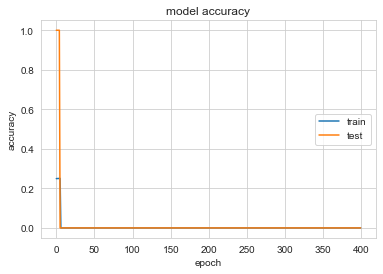

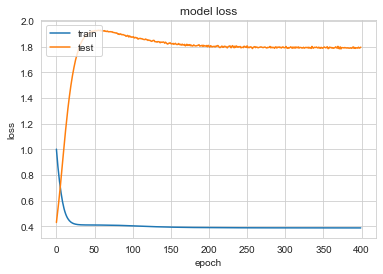

In [236]:
#Learing Curve with Epochs
model = Sequential()
model.add(Dense(2, input_dim=4, activation='sigmoid'))
model.add(Dense(3, activation='sigmoid'))
model.add(Dense(1,activation = 'sigmoid'))
# Compile model
model.compile(loss= 'binary_crossentropy', optimizer='adam', metrics=['acc',f1_m,precision_m, recall_m])
# Fit the model
history = model.fit(co_x_train, co_y_train,validation_split=0.33, epochs=400,batch_size = 200,verbose=0)
# list all data in history
print(history.history.keys())
# summarize history for accuracy
plt.plot(history.history['f1_m'])
plt.plot(history.history['val_f1_m'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='center right')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()